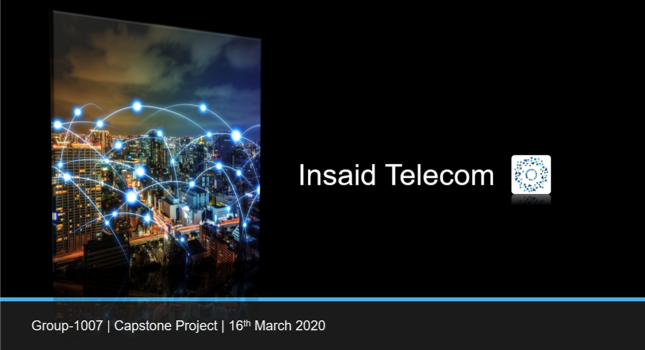

## Table of Content

1. [Import Libraries and create MYSQL connection](#section101)<br>
2. [Data Extraction and Exploration](#section2)<br>
    - 2.1 [Missing Data Imputation](#section201)<br>
         - 2.1.1 [Missing State](#section202)<br>
         - 2.1.2 [Missing Longitude and Latitude](#section203)<br>
         - 2.1.3 [Missing Device_ID](#section204)<br>
    - 2.2 [Anamoly Detection](#section205)<br>
    - 2.3 [Merging Datasets - Phone, Gender and Events](#section206)<br>
3. [Anamoly Detection](#section3)<br>
4. [Plotting of Distributions](#section4)<br>
    - 4.1 [Distribution of Users(device_id) across States](#section400)<br>
    - 4.2 [Distribution of Users across Phone Brands(10 Most used Phone Brands)](#section401)<br>
    - 4.3 [Distribution of Users across Gender](#section402)<br>
    - 4.4 [Distribution of Users across Age Segments](#section403)<br>
    - 4.5 [Distribution of Phone Brands(10 Most used Phone Brand): Age Segment, State, Gender](#section404)<br>
    - 4.6 [Distribution of Gender for each State, Age Segment and Phone Brand(10 Most used Phone Brands)](#section405)<br>
    - 4.7 [Distribution of Age Segments for each State, Gender and Phone Brand(10 Most used Phone Brands)](#section406)<br>
    - 4.8 [Hourly distribution of Phone Calls](#section407)<br>
    - 4.9 [Users on the Map using any suitable package](#section408)<br>
5. [Conclusion](#section5)
6. [CoreTeam](#sectioc6)

<a id=section101></a>
### 1. Import Libraries and Create MySQL Connection

In [1]:
!pip install mysql-connector

Defaulting to user installation because normal site-packages is not writeable


In [2]:
import mysql.connector
import pandas as pd
import numpy as np
import folium
from folium.plugins import MarkerCluster
from collections import Counter

import pandas_profiling
import matplotlib.pyplot as plt  
import seaborn as sns            
%matplotlib inline
sns.set()

#### Connection with the Database

In [ ]:
# connection details
cnx = mysql.connector.connect(
   host="cpanel.insaid.co",
   user="student",
   passwd="student",
   database='Capstone1'
)

<a id=section2></a>
### 2. Data Extraction and Exploration

In [ ]:
# open cursor
cursor = cnx.cursor()
# query
query = "SELECT TABLE_NAME FROM INFORMATION_SCHEMA.TABLES WHERE table_schema ='Capstone1'"
# execute query
cursor.execute(query)
# fetch results
result = cursor.fetchall()
# print results
for table in result:
    print (table)

# close connection
#cnx.close()

In [ ]:
cursor = cnx.cursor()

#### Queries

In [ ]:
query_gender_age_train = ("SELECT * FROM gender_age_train")
query_phone_brand_device_model = ("SELECT * FROM phone_brand_device_model")
#query_events_data = ("select * from events_data where state in ('TamilNadu', 'Manipur', 'Chandigarh', 'Tripura', 'UttarPradesh', 'ArunachalPradesh')")

In [ ]:
cursor.execute(query_gender_age_train)
table_rows = cursor.fetchall()
df_gender_age_train = pd.DataFrame(table_rows,columns = ['device_id','gender','age','group'])

In [ ]:
cursor.execute(query_phone_brand_device_model)
table_rows = cursor.fetchall()
df_phone_brand_device_model = pd.DataFrame(table_rows, columns=['device_id', 'phone_brand', 'device_model'])

In [ ]:
'''
def Read_GDrive_csv():
  #install PyDrive - Commnet If already Installed
  !pip install -U -q PyDrive

  from pydrive.auth import GoogleAuth
  from pydrive.drive import GoogleDrive
  from google.colab import auth
  from oauth2client.client import GoogleCredentials

  auth.authenticate_user()
  gauth = GoogleAuth()
  gauth.credentials = GoogleCredentials.get_application_default()
  drive = GoogleDrive(gauth)

  link = 'https://drive.google.com/open?id=1WMRSPomIeyrVkaEhxYaoeTgcLezVZCjC'
  fluff, id = link.split('=')
  downloaded = drive.CreateFile({'id':id}) 
  downloaded.GetContentFile('events_data.csv')
'''

In [ ]:
'''
import sys
IN_COLAB = 'google.colab' in sys.modules
if(IN_COLAB):
  Read_GDrive_csv()

df_all_events_data = pd.read_csv('events_data.csv')
'''

In [3]:
df_all_events_data = pd.read_csv("~/Downloads/events_data.csv")

In [4]:
df_gender_age_train = pd.read_csv("~/Downloads/gender_age_train.csv")
df_phone_brand_device_model = pd.read_csv("~/Downloads/phone_brand_device_model.csv")

In [5]:
def missing_data(data):
    total = data.isnull().sum().sort_values(ascending = False)
    percent = (data.isnull().sum()/data.isnull().count()*100).sort_values(ascending = False)
    return pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])

In [6]:
missing_data(df_gender_age_train)

,Total,Percent
group,0,0.0
age,0,0.0
gender,0,0.0
device_id,0,0.0


In [7]:
missing_data(df_phone_brand_device_model)

,Total,Percent
device_model,0,0.0
phone_brand,0,0.0
device_id,0,0.0


In [8]:
missing_data(df_all_events_data)

,Total,Percent
device_id,453,0.013926
latitude,423,0.013004
longitude,423,0.013004
state,377,0.011589
city,0,0.000000
timestamp,0,0.000000
event_id,0,0.000000


####  Data Analysis - Gender Age data

In [9]:
df_gender_age_train.shape

(74645, 4)

In [10]:
df_gender_age_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 74645 entries, 0 to 74644
Data columns (total 4 columns):
device_id    74645 non-null int64
gender       74645 non-null object
age          74645 non-null int64
group        74645 non-null object
dtypes: int64(2), object(2)
memory usage: 2.3+ MB


In [11]:
df_gender_age_train.describe()

,device_id,age
count,7.464500e+04,74645.000000
mean,-7.491354e+14,31.410342
std,5.327150e+18,9.868735
min,-9.223067e+18,1.000000
25%,-4.617367e+18,25.000000
50%,-1.841362e+16,29.000000
75%,4.636656e+18,36.000000
max,9.222849e+18,96.000000


In [12]:
df_phone_brand_device_model.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 87726 entries, 0 to 87725
Data columns (total 3 columns):
device_id       87726 non-null int64
phone_brand     87726 non-null object
device_model    87726 non-null object
dtypes: int64(1), object(2)
memory usage: 2.0+ MB


In [13]:
df_gender_age_train.describe(include='all')

,device_id,gender,age,group
count,7.464500e+04,74645,74645.000000,74645
unique,NaN,2,NaN,12
top,NaN,M,NaN,M23-26
freq,NaN,47904,NaN,9605
mean,-7.491354e+14,NaN,31.410342,NaN
std,5.327150e+18,NaN,9.868735,NaN
min,-9.223067e+18,NaN,1.000000,NaN
25%,-4.617367e+18,NaN,25.000000,NaN
50%,-1.841362e+16,NaN,29.000000,NaN
75%,4.636656e+18,NaN,36.000000,NaN


**Observations** No Null Values in Gender Age Data

In [14]:
df_gender_age_train.head()

,device_id,gender,age,group
0,-8076087639492063270,M,35,M32-38
1,-2897161552818060146,M,35,M32-38
2,-8260683887967679142,M,35,M32-38
3,-4938849341048082022,M,30,M29-31
4,245133531816851882,M,30,M29-31


In [15]:
df_gender_age_train['gender'].value_counts()

M    47904
F    26741
Name: gender, dtype: int64

Text(0, 0.5, 'Age Groups')

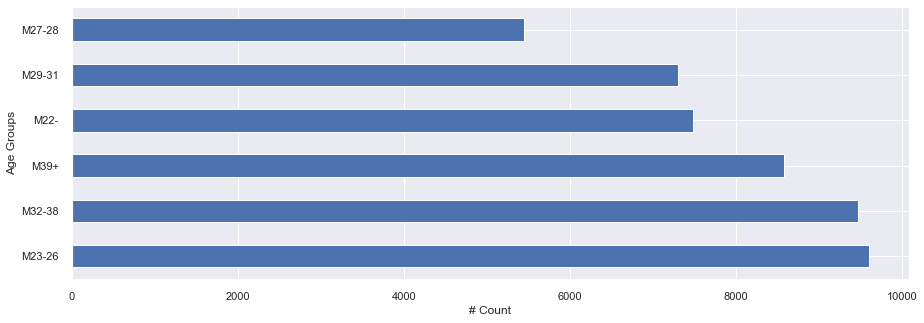

In [16]:
# Male users age group wise to see which group has maximum mobile usage
plt.figure(figsize=(15,5))
df_gender_age_train[df_gender_age_train['gender']=='M']['group'].value_counts().plot.barh()
plt.xlabel("# Count")
plt.ylabel("Age Groups")

Text(0, 0.5, 'Age Groups')

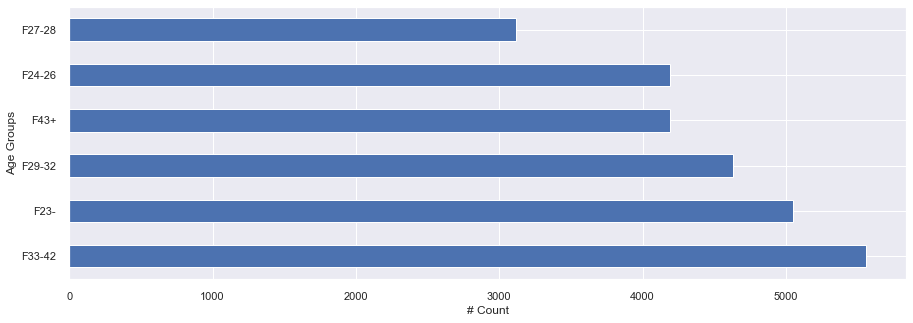

In [17]:
# Female users age group wise to see which group has maximum mobile usage
plt.figure(figsize=(15,5))
df_gender_age_train[df_gender_age_train['gender']=='F']['group'].value_counts().plot.barh()
plt.xlabel("# Count")
plt.ylabel("Age Groups")

Text(0.5, 0, 'Age')

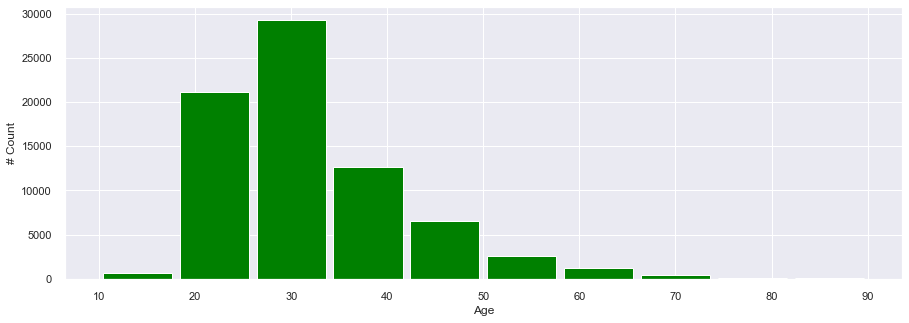

In [18]:
plt.figure(figsize=(15,5))
range = (10,90)
plt.hist(df_gender_age_train['age'], 10, range, color = 'green', histtype = 'bar', rwidth = 0.9)
plt.ylabel("# Count")
plt.xlabel("Age")

Text(0.5, 0, 'Age')

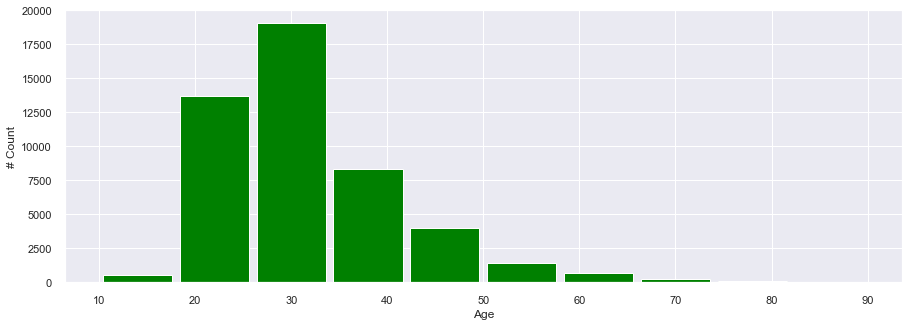

In [19]:
plt.figure(figsize=(15,5))
range = (10,90)
plt.hist(df_gender_age_train[df_gender_age_train['gender']=='M']['age'], 10, range, color = 'green', histtype = 'bar', rwidth = 0.9)
plt.ylabel("# Count")
plt.xlabel("Age")

Text(0.5, 0, 'Age')

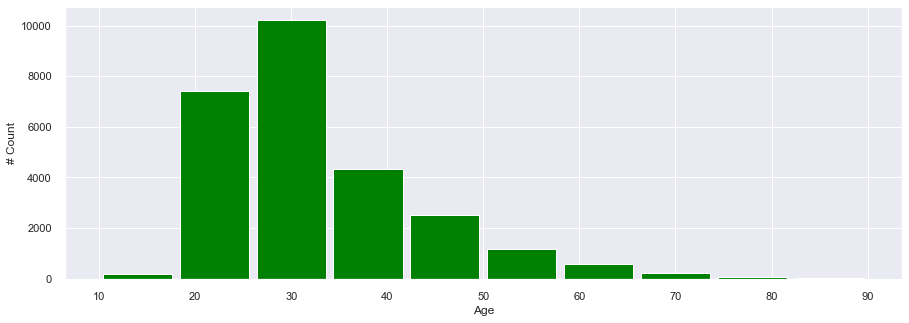

In [20]:
plt.figure(figsize=(15,5))
range = (10,90)
plt.hist(df_gender_age_train[df_gender_age_train['gender']=='F']['age'], 10, range, color = 'green', histtype = 'bar', rwidth = 0.9)
plt.ylabel("# Count")
plt.xlabel("Age")

In [21]:
# profile = pandas_profiling.ProfileReport(df_phone_brand_device_model)
# profile.to_file(output_file="phone_brand_device_model_data_before_preprocessing.html")

In [22]:
# profile = pandas_profiling.ProfileReport(df_gender_age_train)
# profile.to_file(output_file="gender_age_train_data_before_preprocessing.html")

**Observations** 
1. People of age group 20 to 40 are using mobiles more as compared to other age groups.
2. Mojority of people stops using mobile after the age of 60.
3. Males are using mobile more than females.
4. People start using mobile after the age of 10.  

Person whose age is 1 is also using mobile so it is outlier

#### Data Analysis - Phone Brand Data

In [23]:
df_phone_brand_device_model.shape

(87726, 3)

In [24]:
df_phone_brand_device_model.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 87726 entries, 0 to 87725
Data columns (total 3 columns):
device_id       87726 non-null int64
phone_brand     87726 non-null object
device_model    87726 non-null object
dtypes: int64(1), object(2)
memory usage: 2.0+ MB


In [25]:
df_phone_brand_device_model.describe()

,device_id
count,8.772600e+04
mean,-5.212557e+15
std,5.330157e+18
min,-9.223322e+18
25%,-4.623331e+18
50%,-3.109802e+16
75%,4.635194e+18
max,9.222849e+18


In [26]:
df_phone_brand_device_model.describe(include='all')

,device_id,phone_brand,device_model
count,8.772600e+04,87726,87726
unique,NaN,116,1467
top,NaN,小米,红米note
freq,NaN,21645,3500
mean,-5.212557e+15,NaN,NaN
std,5.330157e+18,NaN,NaN
min,-9.223322e+18,NaN,NaN
25%,-4.623331e+18,NaN,NaN
50%,-3.109802e+16,NaN,NaN
75%,4.635194e+18,NaN,NaN


**Observations** No Null Values in Phone Brand Device Data

In [27]:
df_phone_brand_device_model.head()

,device_id,phone_brand,device_model
0,1877775838486905855,vivo,Y13
1,-3766087376657242966,小米,V183
2,-6238937574958215831,OPPO,R7s
3,8973197758510677470,三星,A368t
4,-2015528097870762664,小米,红米Note2


**Observations** There are Chineese names for phone_brand & device_model which needs treatment

In [28]:
brands_in_chinese = ['华为','小米','三星','魅族','酷派','乐视','联想 ','vivo','OPPO','HTC','LG','TCL','LOGO','Lovme','ZUK','PPTV','努比亚','海信','天语','夏新','欧比', '优米', '欧博信', '奇酷', '锤子', '酷比魔方', '语信', '朵唯', '德赛', '一加',
       '华硕', '普耐尔', '易派', '摩托罗拉', '优购', '酷珀', '梦米', '爱派尔', '昂达', '邦华',
       '聆韵', '中国移动', '诺亚信', '酷比', '艾优尼', '斐讯', '富可视', '欧新', '美图', '宝捷讯',
       '青橙', '果米', '波导', '诺基亚', '神舟', '糯米', '亿通', '纽曼', '唯米', '百立丰',
       '沃普丰', '虾米', '凯利通', '贝尔丰', '至尊宝', '蓝魔', '青葱', '白米', '大可乐', '尼比鲁',
       '康佳', '乡米', '黑米', '海尔', '优语', '维图', '米歌', '广信', 'E派', '小杨树', '糖葫芦',
       '西米', '谷歌', '长虹', '飞利浦', '惠普', '台电', '大Q', '鲜米', '先锋', '欧奇']
brands_in_english = ['Huawei','Xiaomi','Samsung','Meizu','Coolpad','LeEco','Lenovo','vivo','OPPO','HTC','LG','TCL','LOGO','Lovme','ZUK','PPTV','Nubia','Hisense','Amagatarai','Amoi','Obi', 'Youmi', 'Obson', 'Qiku', 'Hammer', 'Cubei Cube', 'Letters', 'Duowei', 'Desai', 'One Plus','ASUS', 'Punale', 'Yipai', 'Motorola', 'Yougo', 'Cooper', 'Mengmi', 'Aipair', 'Onda', 'Banghua', 'Lingyun', 'China Mobile', 'Noah',' Coolby ',' Aiyouni ',' Feixun ',' Focus', 'Ou Xin', 'Meitu', 'Projet News','Green Orange', 'Fruit Rice', 'Flyer', 'Nokia', 'Shenzhou', 'Glutinous Rice', 'Yi Tong', 'Newman', 'Wei Mi', 'Bai Li Feng','Wopfung', 'Shrimp', 'Kellystone', 'Bellfonte', 'Extreme Treasure', 'Blue Devils', 'Scallion', 'White Rice', 'Big Cola', 'Nibiru','Kangjia', 'Xianmi', 'Black Rice', 'Haier', 'Youyu', 'Weitu', 'Mi Ge', 'Guangxin', 'E-Pay', 'Little Poplar', ' Candied ','Simi', 'Google', 'Changhong', 'Philips', 'HP', 'Taipower', 'Big Q', 'Fresh Rice', 'Pioneer', 'Ouqi']

brands_dict1 = dict(zip(brands_in_chinese, brands_in_english)) 


In [29]:
def translator(val):
    if val in brands_dict1:
        return brands_dict1[val]
    else:
        return val

In [30]:
df_phone_brand_device_model.phone_brand = df_phone_brand_device_model.phone_brand.apply(translator)

In [31]:
df_phone_brand_device_model.head()

,device_id,phone_brand,device_model
0,1877775838486905855,vivo,Y13
1,-3766087376657242966,Xiaomi,V183
2,-6238937574958215831,OPPO,R7s
3,8973197758510677470,Samsung,A368t
4,-2015528097870762664,Xiaomi,红米Note2


In [32]:
df_phone_brand_device_model['phone_brand'].value_counts().head(10)

Xiaomi     21645
Samsung    19211
Huawei     15181
vivo        7596
OPPO        6717
Meizu       5531
Coolpad     3979
HTC         1272
Lenovo       982
LeEco        841
Name: phone_brand, dtype: int64

Text(0.5, 0, 'Phone Brands')

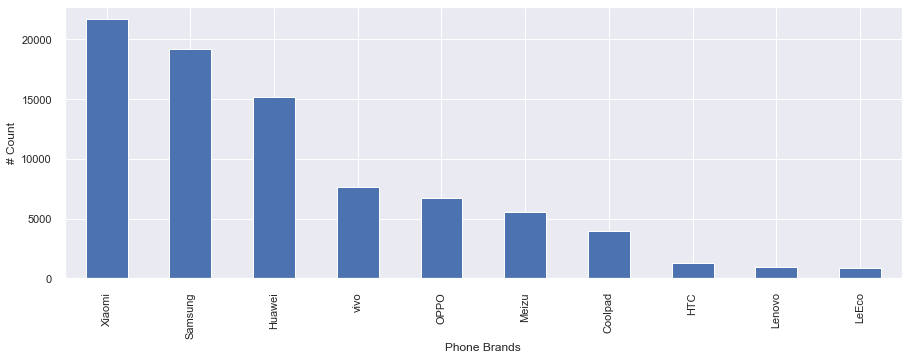

In [33]:
plt.figure(figsize=(15,5))
df_phone_brand_device_model['phone_brand'].value_counts().head(10).plot.bar()
plt.ylabel("# Count")
plt.xlabel("Phone Brands")

In [34]:
df_phone_brand_device_model['device_model'].value_counts().head(10)

红米note           3500
MI 3             2739
MI 2S            2547
Galaxy Note 3    2378
MI 4             2256
Galaxy S4        1910
Galaxy Note 2    1877
荣耀6              1471
荣耀畅玩4X           1279
荣耀3C             1206
Name: device_model, dtype: int64

In [35]:
df_phone_brand_device_model['device_model'].replace({'红米note': 'Redmi note', '荣耀6 plus': 'Redmi 1S', '天鉴W900S': 'Tianjian W900S','乐檬X3': 'Music lemon X3', '荣耀6': 'Glory 6', '荣耀畅玩4X': 'Honor Play 4X', '荣耀3C': 'Glory 3C', '荣耀6 Plus':'Honor 6 Plus' }, inplace=True)

Text(0.5, 0, 'Device Models')

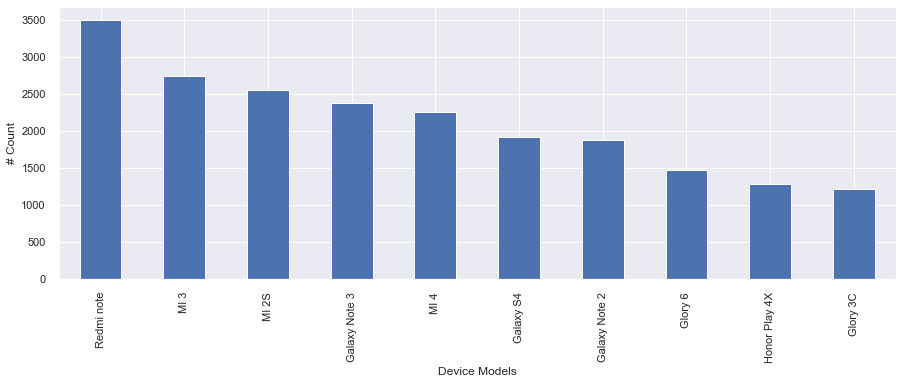

In [36]:
plt.figure(figsize=(15,5))
df_phone_brand_device_model['device_model'].value_counts().head(10).plot.bar()
plt.ylabel("# Count")
plt.xlabel("Device Models")

In [37]:
for i in df_phone_brand_device_model['phone_brand'].head(10).unique():
    print ('-----',i,'------')
    print (df_phone_brand_device_model[df_phone_brand_device_model['phone_brand']==i]['device_model'].value_counts().head())

----- vivo ------
X3T      425
X5Pro    401
X3L      333
Xplay    293
X5SL     279
Name: device_model, dtype: int64
----- Xiaomi ------
Redmi note    3500
MI 3          2739
MI 2S         2547
MI 4          2256
红米1S          1191
Name: device_model, dtype: int64
----- OPPO ------
R7         663
R7 Plus    459
R7s        423
Find 7     381
R3         335
Name: device_model, dtype: int64
----- Samsung ------
Galaxy Note 3    2378
Galaxy S4        1910
Galaxy Note 2    1877
Galaxy S3        1156
Galaxy S5         827
Name: device_model, dtype: int64


#### Data Analysis - Events Data

In [38]:
df_all_events_data.shape

(3252950, 7)

In [39]:
df_all_events_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3252950 entries, 0 to 3252949
Data columns (total 7 columns):
event_id     float64
device_id    float64
timestamp    object
longitude    float64
latitude     float64
city         object
state        object
dtypes: float64(4), object(3)
memory usage: 173.7+ MB


In [40]:
df_all_events_data.describe()

,event_id,device_id,longitude,latitude
count,3.252950e+06,3.252497e+06,3.252527e+06,3.252527e+06
mean,1.626476e+06,1.012200e+17,7.815868e+01,2.168851e+01
std,9.390459e+05,5.316758e+18,4.235570e+00,5.789111e+00
min,1.000000e+00,-9.222957e+18,1.256700e+01,8.190110e+00
25%,8.132382e+05,-4.540611e+18,7.583543e+01,1.780171e+01
50%,1.626476e+06,1.726820e+17,7.726814e+01,2.216454e+01
75%,2.439713e+06,4.861813e+18,8.031916e+01,2.868278e+01
max,3.252950e+06,9.222849e+18,9.545946e+01,4.187190e+01


In [41]:
df_all_events_data[df_all_events_data['state'].isnull()]['city'].unique()

array(['Delhi', 'Pune', 'Chennai', 'Visakhapatnam', 'Indore', 'Jaipur',
       'Arambagh', 'Channapatna', 'Gangarampur'], dtype=object)

<a id=section201></a>
## 2.1 Missing data Imputation 

We have seen above that in events dataset - `state`, `longitude`, `latitude` and `device_id` have missing values, we will be imputing these

<a id=section202></a>
### 2.1.1 Missing State 

In [42]:
#Replacing null states only for `WestBengal`
df_all_events_data.loc[(df_all_events_data['city'] =='Arambagh') \
    & (df_all_events_data['state'].isnull()),'state'] = 'WestBengal'

df_all_events_data.loc[(df_all_events_data['city'] =='Gangarampur') \
    & (df_all_events_data['state'].isnull()),'state'] = 'WestBengal'

#Replacing null states only for `Karnataka`
df_all_events_data.loc[(df_all_events_data['city'] =='Channapatna') \
    & (df_all_events_data['state'].isnull()),'state'] ='Karnataka'


In [43]:
#l = ['TamilNadu', 'Manipur', 'Chandigarh', 'Tripura', 'UttarPradesh', 'ArunachalPradesh']
list_of_states = ['WestBengal', 'Karnataka', 'Gujarat', 'Bihar', 'Punjab', 'Kerala']

In [44]:
df_events_data = df_all_events_data.loc[df_all_events_data['state'].isin(list_of_states)]

In [45]:
df_events_data.shape

(422971, 7)

In [46]:
df_events_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 422971 entries, 2829979 to 3252949
Data columns (total 7 columns):
event_id     422971 non-null float64
device_id    422923 non-null float64
timestamp    422971 non-null object
longitude    422929 non-null float64
latitude     422929 non-null float64
city         422971 non-null object
state        422971 non-null object
dtypes: float64(4), object(3)
memory usage: 25.8+ MB


In [47]:
df_events_data.describe()

,event_id,device_id,longitude,latitude
count,4.229710e+05,4.229230e+05,422929.000000,422929.000000
mean,1.635553e+06,5.464720e+16,82.335301,20.793135
std,9.309153e+05,5.330500e+18,6.381550,5.424496
min,2.088100e+04,-9.221066e+18,12.567400,8.412438
25%,8.229210e+05,-4.582572e+18,76.550601,15.204908
50%,1.632956e+06,1.244607e+17,85.519033,22.620571
75%,2.443386e+06,4.703286e+18,88.408053,23.104146
max,3.252946e+06,9.222849e+18,89.622073,41.871900


In [48]:
df_events_data.describe(include='all')

,event_id,device_id,timestamp,longitude,latitude,city,state
count,4.229710e+05,4.229230e+05,422971,422929.000000,422929.000000,422971,422971
unique,NaN,NaN,290235,NaN,NaN,311,6
top,NaN,NaN,2016-05-05 10:39:01,NaN,NaN,Calcutta,WestBengal
freq,NaN,NaN,15,NaN,NaN,122381,196203
mean,1.635553e+06,5.464720e+16,NaN,82.335301,20.793135,NaN,NaN
std,9.309153e+05,5.330500e+18,NaN,6.381550,5.424496,NaN,NaN
min,2.088100e+04,-9.221066e+18,NaN,12.567400,8.412438,NaN,NaN
25%,8.229210e+05,-4.582572e+18,NaN,76.550601,15.204908,NaN,NaN
50%,1.632956e+06,1.244607e+17,NaN,85.519033,22.620571,NaN,NaN
75%,2.443386e+06,4.703286e+18,NaN,88.408053,23.104146,NaN,NaN


In [49]:
missing_data(df_events_data)

,Total,Percent
device_id,48,0.011348
latitude,42,0.009930
longitude,42,0.009930
state,0,0.000000
city,0,0.000000
timestamp,0,0.000000
event_id,0,0.000000


**Observations** NULL values in `device_id`, `latitude` and `longitude`.

<a id=section203></a>
### 2.1.2 Missing longitude and latitude

**Replace missing `longitude` and `latitude` with mode values**

In [50]:
df_events_data[df_events_data['longitude'].isnull()]['city'].unique()

array(['Moga', 'Araria', 'Bagaha'], dtype=object)

In [51]:
df_events_data[df_events_data['longitude'].isnull()]['state'].unique()

array(['Punjab', 'Bihar'], dtype=object)

In [52]:
pd.reset_option('^display.', silent=True)
c = ['state','city','longitude','latitude']
l = ['Araria','Bagaha','Moga']
df_events_data[c][df_events_data['city'].isin(l)].groupby(df_events_data['city']).describe()

longitude                                                        \
           count       mean       std        min        25%        50%   
city                                                                     
Araria     866.0  87.578218  0.018982  87.533208  87.570736  87.570736   
Bagaha    1581.0  84.147561  0.024195  84.101451  84.140900  84.140900   
Moga      1071.0  75.245817  0.023930  75.189438  75.215865  75.248961   

                             latitude                                  \
              75%        max    count       mean       std        min   
city                                                                    
Araria  87.588191  87.619956    866.0  26.209851  0.012624  26.165540   
Bagaha  84.170164  84.188893   1581.0  27.163957  0.023820  27.115007   
Moga    75.268748  75.268748   1071.0  30.895271  0.021392  30.831398   

                                                    
              25%        50%        75%        max  
city                                                
Araria  26.211919  26.211919  26.211919  26.242987  
Bagaha  27.151011  27.177397  27.177397  27.195515  
Moga    30.888956  30.904178  30.904178  30.918599

In [53]:
Araria_latitude_mode = df_events_data['latitude'][df_events_data['city'] == 'Araria'].mode()
Araria_latitude_mode

0    26.211919
dtype: float64

In [54]:
Bagaha_latitude_mode = df_events_data['latitude'][df_events_data['city'] == 'Bagaha'].mode()
Bagaha_latitude_mode

0    27.177397
dtype: float64

In [55]:
Moga_latitude_mode = df_events_data['latitude'][df_events_data['city'] == 'Moga'].mode()
Moga_latitude_mode

0    30.904178
dtype: float64

In [56]:
Araria_longitude_mode = df_events_data['longitude'][df_events_data['city'] == 'Araria'].mode()
Araria_longitude_mode

0    87.570736
dtype: float64

In [57]:
Bagaha_longitude_mode = df_events_data['longitude'][df_events_data['city'] == 'Bagaha'].mode()
Bagaha_longitude_mode

0    84.1409
dtype: float64

In [58]:
Moga_longitude_mode = df_events_data['longitude'][df_events_data['city'] == 'Moga'].mode()
Moga_longitude_mode

0    75.268748
dtype: float64

In [59]:
df_events_data_copy = df_events_data

In [60]:
df_events_data_copy.shape

(422971, 7)

In [61]:
#Replacing missing longitude & latitude in `Araria`,`Bagaha` & `Moga`
df_events_data.loc[(df_events_data['city'] =='Araria') \
                   & (df_events_data['longitude'].isnull()),'longitude']= '87.578218'
df_events_data.loc[(df_events_data['city'] =='Araria') \
                   & (df_events_data['latitude'].isnull()),'latitude']= '26.209851'

df_events_data.loc[(df_events_data['city'] =='Bagaha') \
                       & (df_events_data['longitude'].isnull()), 'longitude']= '84.147561'
df_events_data.loc[(df_events_data['city'] =='Bagaha') \
                   & (df_events_data['latitude'].isnull()),'latitude']= '27.163957'

df_events_data.loc[(df_events_data['city'] =='Moga') \
                       & (df_events_data['longitude'].isnull()), 'longitude']= '75.245817'
df_events_data.loc[(df_events_data['city'] =='Moga') \
                   & (df_events_data['latitude'].isnull()),'latitude']= '30.895271'

/Users/pratikajitb/anaconda3/lib/python3.7/site-packages/pandas/core/indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


In [62]:
df_events_data.head()

,event_id,device_id,timestamp,longitude,latitude,city,state
2829979,74778.0,6.173131e+18,2016-05-01 08:02:02,88.3975,22.6522,Calcutta,WestBengal
2829980,527238.0,6.173131e+18,2016-05-02 21:03:22,88.3975,22.6522,Calcutta,WestBengal
2829981,1264753.0,6.173131e+18,2016-05-06 21:36:26,88.3975,22.6522,Calcutta,WestBengal
2829982,2252310.0,6.173131e+18,2016-05-03 23:02:19,88.3975,22.6522,Calcutta,WestBengal
2829983,2318262.0,6.173131e+18,2016-05-03 09:11:20,88.3975,22.6522,Calcutta,WestBengal


<a id=section204></a>
### 2.1.3 Missing Device_ID

In [63]:
df_events_data[df_events_data['device_id'].isnull()]['city'].unique()

array(['Jetpur', 'Hoshiarpur', 'Bardoli'], dtype=object)

In [64]:
df_events_data[df_events_data['device_id'].isnull()].groupby(df_events_data['city']).count()

,event_id,device_id,timestamp,longitude,latitude,city,state
city,,,,,,,
Bardoli,16,0,16,16,16,16,16
Hoshiarpur,16,0,16,16,16,16,16
Jetpur,16,0,16,16,16,16,16


**Replace missing `device_id` with mode values**

In [65]:
pd.options.display.float_format = '{:30,.1f}'.format
df_events_data['device_id'][df_events_data['city']=='Jetpur'].mode()

0     -1,688,015,122,502,424,064.0
dtype: float64

In [66]:
df_events_data['device_id'][df_events_data['city']=='Bardoli'].mode()

0     -8,215,770,519,233,686,528.0
dtype: float64

In [67]:
df_events_data['device_id'][df_events_data['city']=='Hoshiarpur'].mode()

0      1,750,778,632,182,066,944.0
dtype: float64

In [68]:
#Replacing missing `device_id` in Jetpur, Bardoli and Hoshiarpur
df_events_data.loc[(df_events_data['city'] =='Jetpur') \
                   & (df_events_data['device_id'].isnull()),'device_id']= '-1688015122502424064'

df_events_data.loc[(df_events_data['city'] =='Bardoli') \
                       & (df_events_data['device_id'].isnull()), 'device_id']= '-8215770519233686528'

df_events_data.loc[(df_events_data['city'] =='Hoshiarpur') \
                       & (df_events_data['device_id'].isnull()), 'device_id']= '-1750778632182066944'


In [69]:
ll = ['Jetpur', 'Hoshiarpur', 'Bardoli']
df_events_data[df_events_data['city'].isin(ll)].groupby(df_events_data['city']).count()

,event_id,device_id,timestamp,longitude,latitude,city,state
city,,,,,,,
Bardoli,1475,1475,1475,1475,1475,1475,1475
Hoshiarpur,914,914,914,914,914,914,914
Jetpur,1479,1479,1479,1479,1479,1479,1479


In [70]:
missing_data(df_events_data)

,Total,Percent
state,0,0.0
city,0,0.0
latitude,0,0.0
longitude,0,0.0
timestamp,0,0.0
device_id,0,0.0
event_id,0,0.0


<a id=section205></a>
### 2.2 Anomaly Detection [Outliers] 

In [71]:
df_events_data.loc[:,'longitude':'latitude']=df_events_data.loc[:,'longitude':'latitude'].astype(float)

In [72]:
df_events_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 422971 entries, 2829979 to 3252949
Data columns (total 7 columns):
event_id     422971 non-null float64
device_id    422971 non-null object
timestamp    422971 non-null object
longitude    422971 non-null float64
latitude     422971 non-null float64
city         422971 non-null object
state        422971 non-null object
dtypes: float64(3), object(4)
memory usage: 45.8+ MB


Text(0.5, 0, 'Longitude')

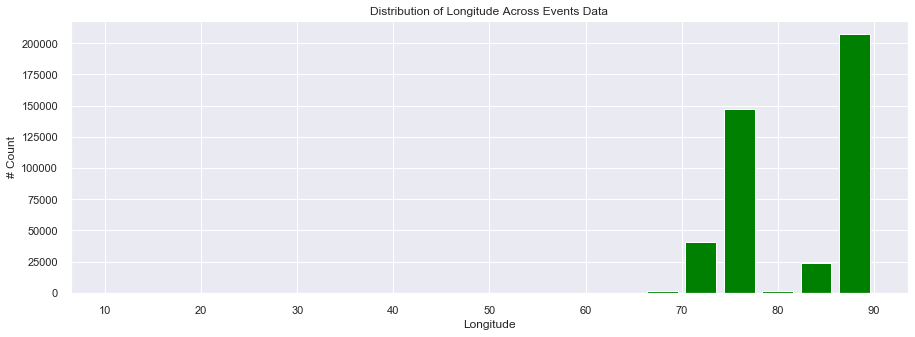

In [73]:
plt.figure(figsize=(15,5))
plt.hist(df_events_data['longitude'], 20, range, color = 'green', histtype = 'bar', rwidth = 0.8)
plt.title('Distribution of Longitude Across Events Data');
plt.ylabel("# Count")
plt.xlabel("Longitude")

Text(0.5, 0, 'Latitude')

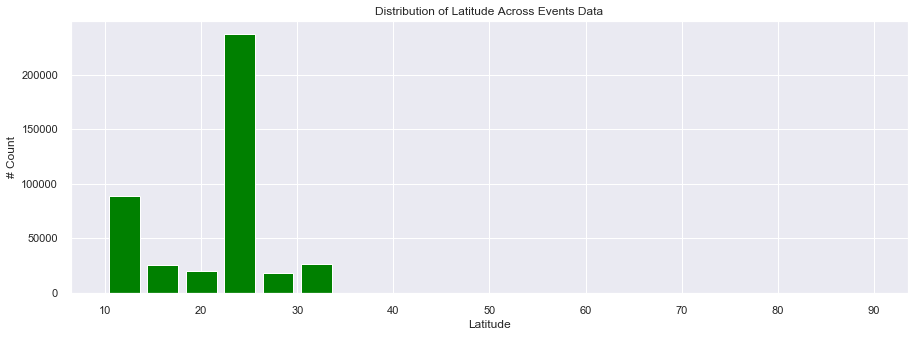

In [74]:
plt.figure(figsize=(15,5))
plt.hist(df_events_data['latitude'], 20, range, color = 'green', histtype = 'bar', rwidth = 0.8)
plt.title('Distribution of Latitude Across Events Data');
plt.ylabel("# Count")
plt.xlabel("Latitude")

Text(0, 0.5, '# Value')

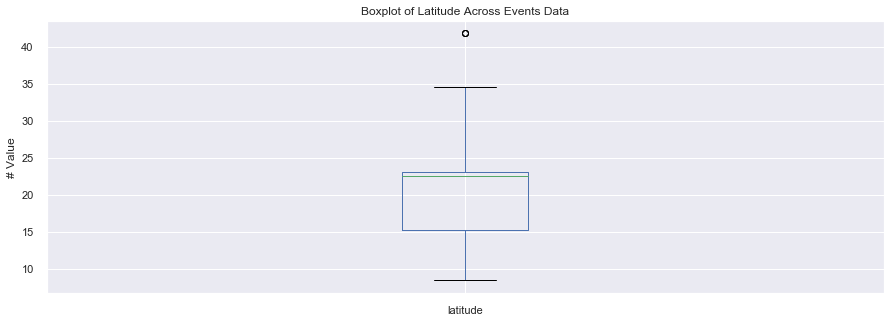

In [75]:
plt.figure(figsize=(15,5))
boxplot = df_events_data.boxplot(column='latitude')
plt.title('Boxplot of Latitude Across Events Data');
plt.ylabel("# Value")

In [76]:
df_events_data[df_events_data['latitude']>35]

,event_id,device_id,timestamp,longitude,latitude,city,state
3017977,"286,380.0","6,171,733,141,545,328,640.0",2016-05-02 21:12:53,12.6,41.9,Purnia,Bihar
3017992,"515,181.0","6,171,733,141,545,328,640.0",2016-05-02 21:23:51,12.6,41.9,Purnia,Bihar
3017995,"560,457.0","6,171,733,141,545,328,640.0",2016-05-04 22:35:39,12.6,41.9,Purnia,Bihar


In [77]:
df_events_data[df_events_data['city']=='Purnia']['latitude'].mode()

0                             25.9
dtype: float64

In [78]:
mylist = df_events_data[df_events_data['latitude']>35]['event_id'].index.to_list()
for i in mylist:
    df_events_data.at[i,'latitude']=df_events_data[df_events_data['city']=='Purnia']['latitude'].mode()

Text(0, 0.5, '# Value')

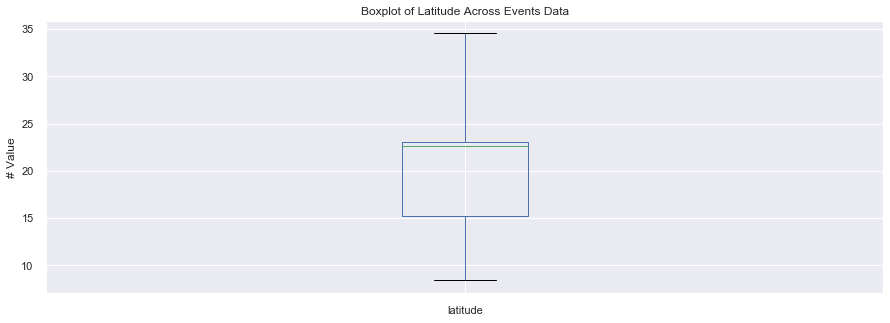

In [79]:
plt.figure(figsize=(15,5))
boxplot = df_events_data.boxplot(column='latitude')
plt.title('Boxplot of Latitude Across Events Data');
plt.ylabel("# Value")

Text(0, 0.5, '# Value')

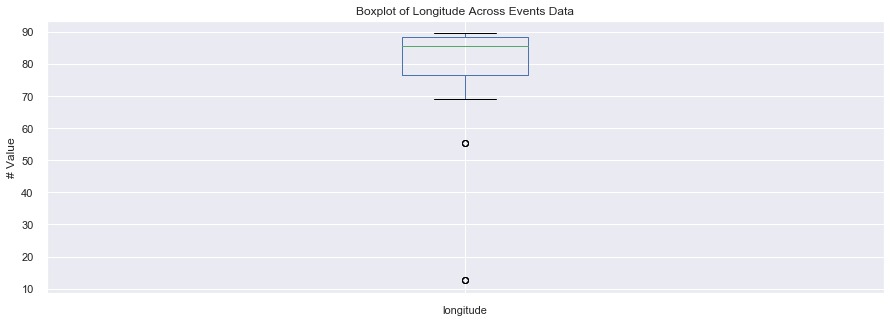

In [80]:
plt.figure(figsize=(15,5))
boxplot = df_events_data.boxplot(column='longitude')
plt.title('Boxplot of Longitude Across Events Data');
plt.ylabel("# Value")

In [81]:
df_events_data[df_events_data['longitude']<68]

,event_id,device_id,timestamp,longitude,latitude,city,state
3017977,"286,380.0","6,171,733,141,545,328,640.0",2016-05-02 21:12:53,12.6,25.9,Purnia,Bihar
3017992,"515,181.0","6,171,733,141,545,328,640.0",2016-05-02 21:23:51,12.6,25.9,Purnia,Bihar
3017995,"560,457.0","6,171,733,141,545,328,640.0",2016-05-04 22:35:39,12.6,25.9,Purnia,Bihar
3064342,"268,673.0","-6,903,863,101,719,990,272.0",2016-05-03 05:47:04,55.3,25.2,Ilkal,Karnataka
3064357,"455,933.0","-6,903,863,101,719,990,272.0",2016-05-04 18:36:32,55.3,25.2,Ilkal,Karnataka
3064360,"479,734.0","-6,903,863,101,719,990,272.0",2016-05-06 06:23:06,55.3,25.2,Ilkal,Karnataka


In [82]:
df_events_data[df_events_data['city']=='Purnia']['longitude'].mode()

0                             87.5
dtype: float64

In [83]:
df_events_data[df_events_data['city']=='Ilkal']['longitude'].mode()

0                             76.2
dtype: float64

In [84]:
mylist1 = df_events_data[(df_events_data['longitude']<68) \
                         & (df_events_data['city']=='Purnia')]['event_id'].index.to_list()
for i in mylist1:
    df_events_data.at[i,'longitude']=df_events_data[df_events_data['city']=='Purnia']['longitude'].mode()
    
mylist2 = df_events_data[(df_events_data['longitude']<68) \
                         & (df_events_data['city']=='Ilkal')]['event_id'].index.to_list()
for i in mylist2:
    df_events_data.at[i,'longitude']=df_events_data[df_events_data['city']=='Ilkal']['longitude'].mode()

Text(0, 0.5, '# Value')

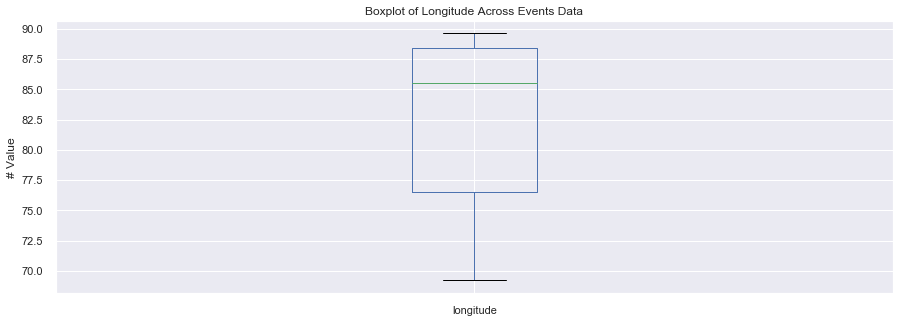

In [85]:
plt.figure(figsize=(15,5))
boxplot = df_events_data.boxplot(column='longitude')
plt.title('Boxplot of Longitude Across Events Data');
plt.ylabel("# Value")

Text(0.5, 0, 'Latitude')

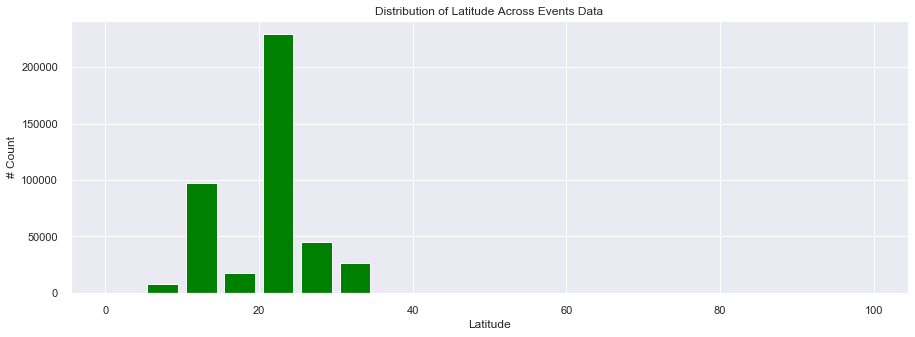

In [86]:
plt.figure(figsize=(15,5))
range = (0,100)
plt.hist(df_events_data['latitude'], 20, range, color = 'green', histtype = 'bar', rwidth = 0.8)
plt.title('Distribution of Latitude Across Events Data');
plt.ylabel("# Count")
plt.xlabel("Latitude")

Text(0.5, 0, 'Longitude')

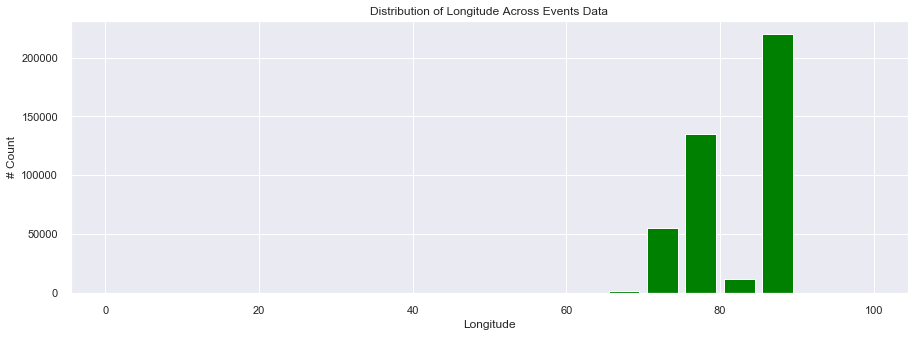

In [87]:
plt.figure(figsize=(15,5))
range = (0,100)
plt.hist(df_events_data['longitude'], 20, range, color = 'green', histtype = 'bar', rwidth = 0.8)
plt.title('Distribution of Longitude Across Events Data');
plt.ylabel("# Count")
plt.xlabel("Longitude")

<a id=section206></a>
### 2.3 Merging Datasets - Phone, Gender and Events

In [88]:
df_gender_age_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 74645 entries, 0 to 74644
Data columns (total 4 columns):
device_id    74645 non-null int64
gender       74645 non-null object
age          74645 non-null int64
group        74645 non-null object
dtypes: int64(2), object(2)
memory usage: 2.3+ MB


In [89]:
df_phone_brand_device_model.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 87726 entries, 0 to 87725
Data columns (total 3 columns):
device_id       87726 non-null int64
phone_brand     87726 non-null object
device_model    87726 non-null object
dtypes: int64(1), object(2)
memory usage: 2.0+ MB


In [90]:
df_events_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 422971 entries, 2829979 to 3252949
Data columns (total 7 columns):
event_id     422971 non-null float64
device_id    422971 non-null object
timestamp    422971 non-null object
longitude    422971 non-null float64
latitude     422971 non-null float64
city         422971 non-null object
state        422971 non-null object
dtypes: float64(3), object(4)
memory usage: 45.8+ MB


In [91]:
df_gender_age_train['device_id']=df_gender_age_train['device_id'].astype(float)

In [92]:
df_phone_brand_device_model['device_id']=df_phone_brand_device_model['device_id'].astype(float)

In [93]:
df_events_data['device_id']=df_events_data['device_id'].astype(float)

/Users/pratikajitb/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [94]:
df_final = df_events_data.merge(df_phone_brand_device_model,on='device_id').merge(df_gender_age_train,on='device_id')

In [95]:
df_final.shape

(312393, 12)

In [96]:
missing_data(df_final)

,Total,Percent
group,0,0.0
age,0,0.0
gender,0,0.0
device_model,0,0.0
phone_brand,0,0.0
state,0,0.0
city,0,0.0
latitude,0,0.0
longitude,0,0.0
timestamp,0,0.0


In [97]:
df_events_data['timestamp']=pd.to_datetime(df_events_data['timestamp'])

/Users/pratikajitb/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [98]:
df_final.columns

Index(['event_id', 'device_id', 'timestamp', 'longitude', 'latitude', 'city',
       'state', 'phone_brand', 'device_model', 'gender', 'age', 'group'],
      dtype='object')

In [99]:
CONTINUOUS_COLUMNS = ["age", "latitude", "longitude"]

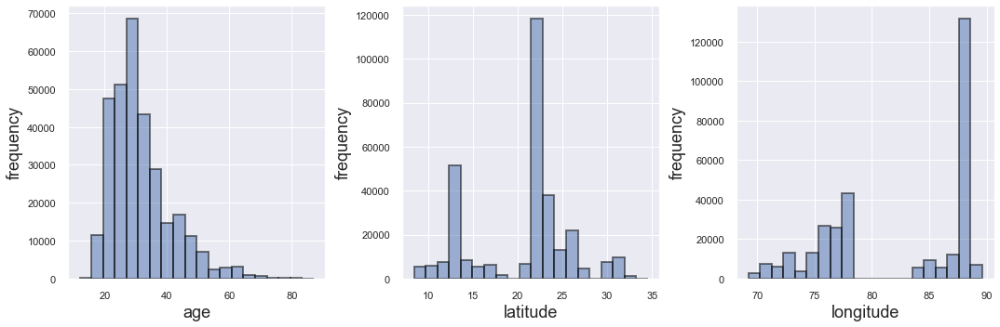

In [100]:
def plot_histgrams(data):
    ncols = len(data.columns)
    fig = plt.figure(figsize=(5 * 5, 5 * (ncols // 5 + 1)))
    for i, col in enumerate(data.columns):
        X = data[col].dropna()
        plt.subplot(ncols // 5 + 1, 5, i + 1)
        plt.hist(X, bins=20, alpha=0.5, \
                 edgecolor="black", linewidth=2.0)
        plt.xlabel(col, fontsize=18)
        plt.ylabel("frequency", fontsize=18)
    fig.tight_layout()
    plt.show()

plot_histgrams(df_final[CONTINUOUS_COLUMNS])

In [101]:
CATEGORICAL_COLUMNS = ["group", "gender", "state"]

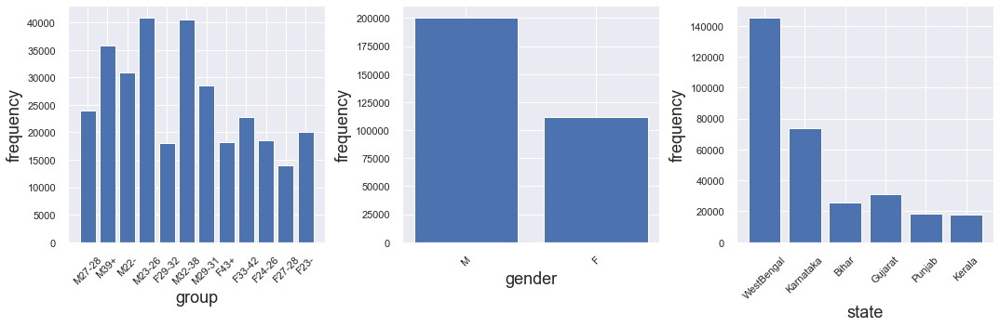

In [102]:


def plot_categoricals(data):
    ncols = len(data.columns)
    fig = plt.figure(figsize=(5 * 5, 5 * (ncols // 5 + 1)))
    for i, col in enumerate(data.columns):
        cnt = Counter(data[col])
        keys = list(cnt.keys())
        vals = list(cnt.values())
        #range(len(keys))
        plt.subplot(ncols // 5 + 1, 5, i + 1)
        plt.bar(keys, vals, align="center")
        plt.xticks(keys, keys, rotation=45)
        plt.xlabel(col, fontsize=18)
        plt.ylabel("frequency", fontsize=18)
    fig.tight_layout()
    plt.show()

plot_categoricals(df_final[CATEGORICAL_COLUMNS])

In [103]:
df_final.groupby(['state', 'phone_brand']).device_model.value_counts().nlargest(10)

state       phone_brand  device_model 
WestBengal  Xiaomi       Redmi note       6366
                         MI 4             5066
                         MI 3             4063
            Samsung      Galaxy Note 3    3510
            Xiaomi       MI 2S            3273
            Samsung      Galaxy Note 2    3034
Karnataka   Xiaomi       Redmi note       3014
WestBengal  Huawei       Glory 6          2806
            Samsung      Galaxy S4        2638
Karnataka   Xiaomi       MI 2S            2157
Name: device_model, dtype: int64

In [104]:
df_final.groupby(['phone_brand','device_model']).agg(lambda x:x.value_counts().index[0])

event_id  \
phone_brand device_model                                    
 Aiyouni    U2                                  127,840.0   
            U3                                1,302,864.0   
            i1                                3,082,234.0   
 Candied    T3                                  767,423.0   
 Coolby     A690                                369,759.0   
            H1                                1,010,884.0   
            H1S                               1,344,159.0   
            H2                                3,181,836.0   
            H3                                1,740,741.0   
            M1                                2,835,983.0   
            M1L                                 239,950.0   
            MAX3                              2,323,958.0   
            S1                                1,042,274.0   
            S2                                1,782,783.0   
            S3                                1,685,884.0   
            S5                                2,763,645.0   
 Feixun     C630Lw                              109,710.0   
            C730Lw                            2,487,163.0   
 Focus      M310                                809,727.0   
            M512                              1,454,846.0   
ASUS        ME371MG                           3,108,653.0   
            ZenFone 2                           530,814.0   
            ZenFone 5                         1,281,733.0   
            ZenFone Selfie                      300,815.0   
            飞马                                1,533,679.0   
            飞马2 Plus                          1,757,822.0   
            飞马3                               1,681,661.0   
Aipair      IPH8                                402,703.0   
            iPh-800                           1,393,660.0   
Amagatarai  C666t                             3,062,824.0   
...                                                   ...   
vivo        Y13iL                             3,168,253.0   
            Y15                               2,118,813.0   
            Y17T                                403,967.0   
            Y17W                              1,157,118.0   
            Y18L                              1,458,167.0   
            Y19T                              2,280,440.0   
            Y20T                                981,617.0   
            Y22                                 576,596.0   
            Y22IL                             1,107,967.0   
            Y22L                              2,605,048.0   
            Y23L                              2,296,678.0   
            Y27                               1,008,875.0   
            Y28L                                876,029.0   
            Y29L                                721,471.0   
            Y33                                 861,182.0   
            Y35                               1,084,412.0   
            Y37                               2,762,750.0   
            Y3T                               2,089,468.0   
            Y51                                 915,484.0   
            Y613                              1,774,586.0   
            Y613F                             1,984,767.0   
            Y622                                636,527.0   
            Y623                                389,957.0   
            Y627                                975,295.0   
            Y628                              3,057,901.0   
            Y913                              1,729,531.0   
            Y923                              1,846,780.0   
            Y927                              3,022,824.0   
            Y928                              1,133,951.0   
            Y937                              1,847,353.0   

                                                device_id  \
phone_brand device_model                                    
 Aiyouni    U2                3,560,071,015,913,409,024.0   
            U3        

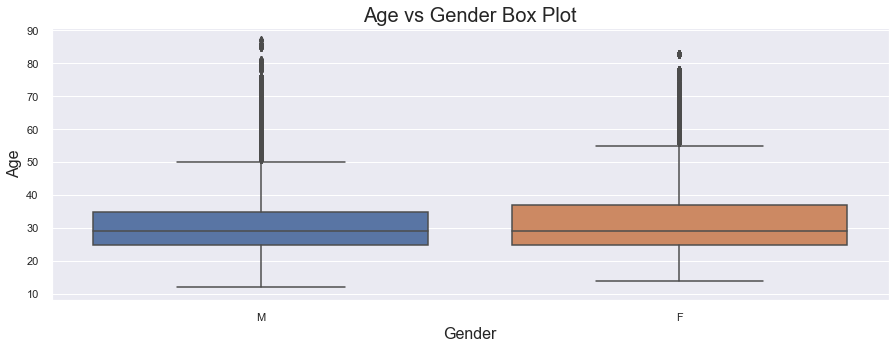

In [105]:
plt.figure(figsize=(15,5))
sns.boxplot(df_final['gender'], df_final['age'])
plt.title('Age vs Gender Box Plot', fontsize=20)      
plt.xlabel('Gender', fontsize=16)
plt.ylabel('Age', fontsize=16)
plt.show()

In [106]:
df_WestBengal = df_events_data[df_events_data.state =='WestBengal']

In [107]:
#profile = pandas_profiling.ProfileReport(df_WestBengal)
#profile.to_file(output_file="westbengal_profiling.html")

In [108]:
df_Karnataka = df_events_data[df_events_data.state =='Karnataka']

In [109]:
#profile = pandas_profiling.ProfileReport(df_Karnataka)
#profile.to_file(output_file="karnataka_profiling.html")

In [110]:
df_Gujarat = df_events_data[df_events_data.state =='Gujarat']

In [111]:
#profile = pandas_profiling.ProfileReport(df_Gujarat)
#profile.to_file(output_file="gujarat_profiling.html")

In [112]:
df_Bihar = df_events_data[df_events_data.state =='Bihar']

In [113]:
#profile = pandas_profiling.ProfileReport(df_Bihar)
#profile.to_file(output_file="bihar_profiling.html")

In [114]:
df_Punjab = df_events_data[df_events_data.state =='Punjab']

In [115]:
#profile = pandas_profiling.ProfileReport(df_Punjab)
#profile.to_file(output_file="punjab_profiling.html")

In [116]:
df_Kerala = df_events_data[df_events_data.state =='Kerala']

In [117]:
#profile = pandas_profiling.ProfileReport(df_Kerala)
#profile.to_file(output_file="kerala_profiling.html")

In [118]:
df_final.describe(include='all')

,event_id,device_id,timestamp,longitude,latitude,city,state,phone_brand,device_model,gender,age,group
count,"312,393.0","312,393.0",312393,"312,393.0","312,393.0",312393,312393,312393,312393,312393,"312,393.0",312393
unique,nan,nan,234622,nan,nan,311,6,87,992,2,nan,12
top,nan,nan,2016-05-05 10:39:01,nan,nan,Calcutta,WestBengal,Xiaomi,Redmi note,M,nan,M23-26
freq,nan,nan,15,nan,nan,90451,145559,79843,13206,200728,nan,40973
mean,"1,634,878.6","-9,811,624,390,100,656.0",NaN,82.4,20.7,NaN,NaN,NaN,NaN,NaN,31.5,NaN
std,"931,453.3","5,196,012,878,652,539,904.0",NaN,6.4,5.4,NaN,NaN,NaN,NaN,NaN,9.8,NaN
min,"20,881.0","-9,220,830,859,283,100,672.0",NaN,69.2,8.4,NaN,NaN,NaN,NaN,NaN,12.0,NaN
25%,"821,364.0","-4,659,474,405,864,672,256.0",NaN,76.6,14.9,NaN,NaN,NaN,NaN,NaN,25.0,NaN
50%,"1,631,928.0","38,630,124,769,588,888.0",NaN,85.5,22.6,NaN,NaN,NaN,NaN,NaN,29.0,NaN
75%,"2,443,432.0","4,682,031,842,235,089,920.0",NaN,88.4,23.1,NaN,NaN,NaN,NaN,NaN,36.0,NaN


In [119]:
df_final['device_id'].nunique()

13996

In [120]:
df_final.shape

(312393, 12)

In [121]:
df_final['timestamp']=pd.to_datetime(df_final['timestamp'])

In [122]:
df_final.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 312393 entries, 0 to 312392
Data columns (total 12 columns):
event_id        312393 non-null float64
device_id       312393 non-null float64
timestamp       312393 non-null datetime64[ns]
longitude       312393 non-null float64
latitude        312393 non-null float64
city            312393 non-null object
state           312393 non-null object
phone_brand     312393 non-null object
device_model    312393 non-null object
gender          312393 non-null object
age             312393 non-null int64
group           312393 non-null object
dtypes: datetime64[ns](1), float64(4), int64(1), object(6)
memory usage: 41.0+ MB


In [123]:
df_final.describe()

,event_id,device_id,longitude,latitude,age
count,"312,393.0","312,393.0","312,393.0","312,393.0","312,393.0"
mean,"1,634,878.6","-9,811,624,390,100,656.0",82.4,20.7,31.5
std,"931,453.3","5,196,012,878,652,539,904.0",6.4,5.4,9.8
min,"20,881.0","-9,220,830,859,283,100,672.0",69.2,8.4,12.0
25%,"821,364.0","-4,659,474,405,864,672,256.0",76.6,14.9,25.0
50%,"1,631,928.0","38,630,124,769,588,888.0",85.5,22.6,29.0
75%,"2,443,432.0","4,682,031,842,235,089,920.0",88.4,23.1,36.0
max,"3,252,946.0","9,222,849,349,208,140,800.0",89.6,34.6,87.0


<a id=section3></a>
### 3. Anamoly Detection

In [124]:

# Make an empty map
map = folium.Map(location=[22.356359, 79.395484], zoom_start=5)
mc = MarkerCluster()
state_list = ['WestBengal', 'Karnataka', 'Gujarat', 'Bihar', 'Punjab', 'Kerala']

for state in state_list:
    mapping_data = df_events_data[['latitude', 'longitude','city']][df_events_data['state']==state].drop_duplicates()
    latitude_list = []
    longitude = []
    citylist = []
    for city in mapping_data.city.unique().tolist():
        latitude_list.append(mapping_data.latitude[mapping_data['city']==city].mean())
        longitude.append(mapping_data.longitude[mapping_data['city']==city].mean())   
        citylist.append(city)
    
    df_data = pd.DataFrame(
    {'latitude' : latitude_list,
     'longitude' : longitude,
     'city' : citylist
    })
    
    locations = df_data[['latitude', 'longitude']]
    locationlist = locations.values.tolist()
    
    for index, item in enumerate(locationlist):
        mc.add_child(folium.Marker(location=item, popup=citylist[index]))
                             
map.add_child(mc)
map.save("state_wise_map_plot.html")
map

In [125]:
locations = df_events_data[['longitude','latitude']]
locations.reset_index(drop=True,inplace=True)
colordict = {0: 'lightblue', 1: 'lightgreen', 2: 'orange', 3: 'red'}


In [126]:
city_map = folium.Map(location=[20.5937,78.9629],zoom_start=5)

In [127]:
df = df_events_data[['latitude','longitude','city','state']]
df = df.drop_duplicates(keep='first',).reset_index()

In [128]:
for lat,long,city,state in zip(df['latitude'],df['longitude'],df['city'],df['state']):
    folium.CircleMarker(location=[lat,long],fill_opacity=0.7,fill=True,key_on =state,color='b', \
                        radius=2,weight=0).add_to(city_map)

In [129]:
city_map.save("city_wise_map_plot.html")
city_map

<a id=section4></a>
## 4. Plotting Distributions

In [130]:
user_data = df_final.drop(['event_id','timestamp'],axis=1)
user_data = user_data.drop_duplicates(keep='first').reset_index()
print(user_data.shape)
user_data.head(2)

(14000, 11)


,index,device_id,longitude,latitude,city,state,phone_brand,device_model,gender,age,group
0,0,"6,173,131,034,529,612,800.0",88.4,22.7,Calcutta,WestBengal,vivo,X5V,M,28,M27-28
1,6,"-5,235,317,150,879,700,992.0",88.4,22.6,Calcutta,WestBengal,LG,G3,M,41,M39+


<a id=section400></a>
### 4.1 Distribution of Users(device_id) across States

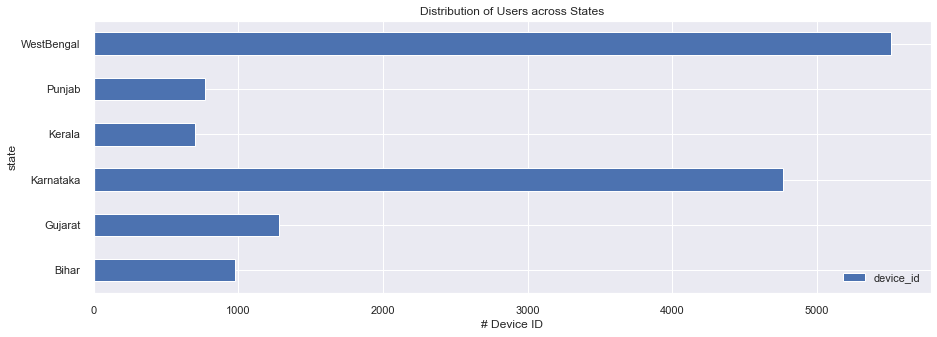

In [131]:
plt.figure(figsize=(15,5))
user_data.groupby('state').device_id.count().plot(kind='barh')
plt.title('Distribution of Users across States');
plt.xlabel("# Device ID")
plt.legend();

<a id=section401></a>
### 4.2 Distribution of Users across Phone Brands(10 Most used Phone Brands)

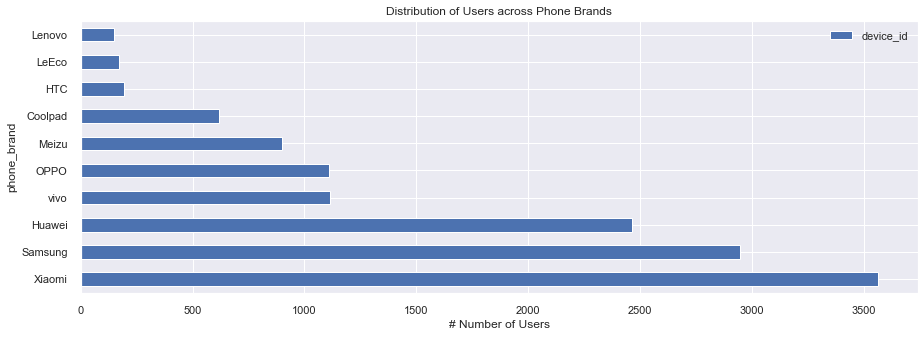

In [132]:
plt.figure(figsize=(15,5))
user_data.groupby('phone_brand').device_id.count().sort_values(ascending=False).head(10).plot(kind='barh')
plt.title('Distribution of Users across Phone Brands');
plt.xlabel('# Number of Users');
plt.legend();

Text(0.5, 1.0, 'Phone Brand Distribution Across States')

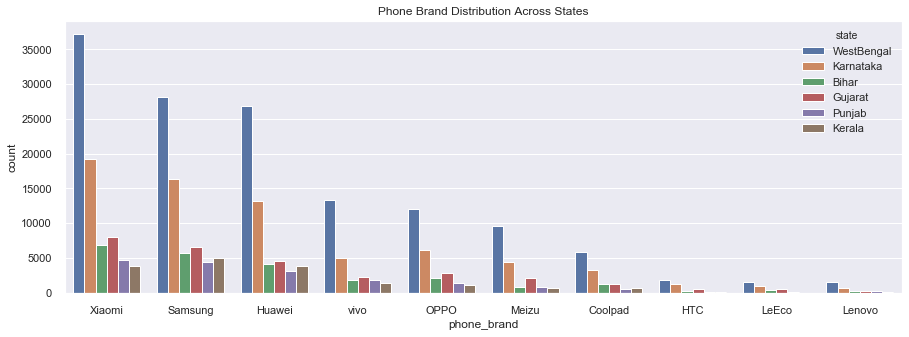

In [133]:
fig, axis1 = plt.subplots(1,1,figsize=(15,5))
sns.countplot(x='phone_brand', hue="state",order=df_final.phone_brand.value_counts().iloc[:10].index, data=df_final, ax=axis1)
plt.title("Phone Brand Distribution Across States")

Text(0.5, 1.0, 'Device Model Distribution Across States')

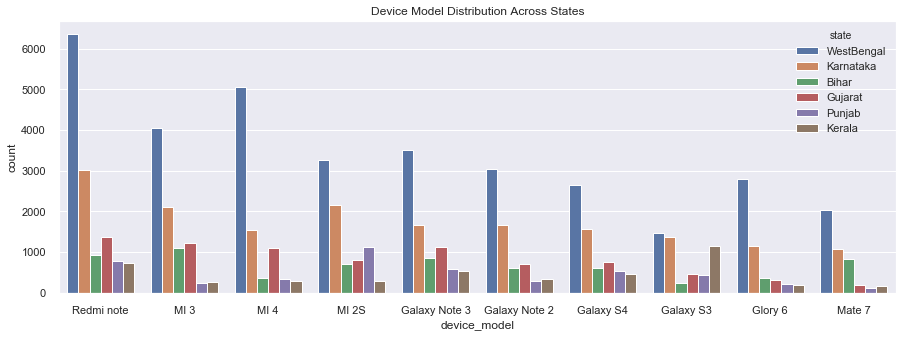

In [134]:
fig, axis1 = plt.subplots(1,1,figsize=(15,5))
sns.countplot(x='device_model', hue="state",order=df_final.device_model.value_counts().iloc[:10].index, data=df_final, ax=axis1)
plt.title("Device Model Distribution Across States")

<a id=section402></a>
### 4.3 Distribution of Users across Gender

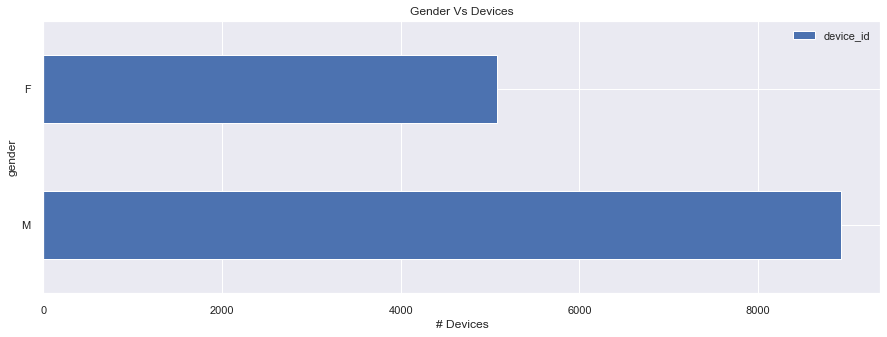

In [135]:
plt.figure(figsize=(15,5))
user_data.groupby('gender').device_id.count().sort_values(ascending=False).plot(kind='barh')
plt.title('Gender Vs Devices')
plt.xlabel('# Devices')
plt.legend()

Text(0.5, 1.0, 'Gender Distribution')

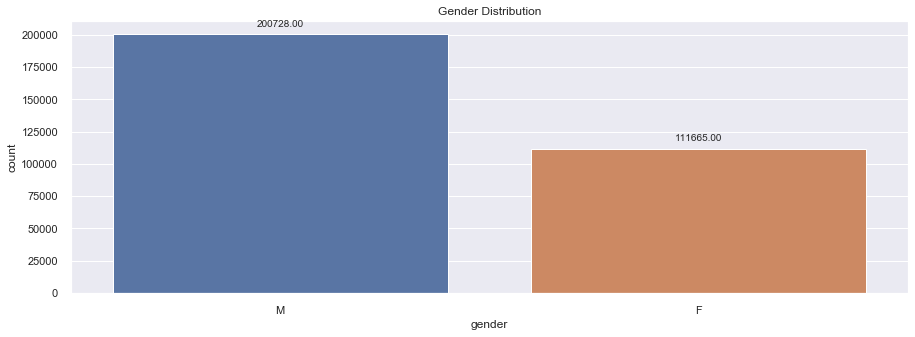

In [136]:
axis1 = plt.subplots(1,1,figsize=(15,5))
splot = sns.countplot(x='gender',data=df_final)
for p in splot.patches:
    splot.annotate(format(p.get_height(), '.2f'), (p.get_x() + p.get_width() / 2., p.get_height()), \
                   ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')

plt.title("Gender Distribution")

M    200728
F    111665
Name: gender, dtype: int64


Text(0.5, 1.0, 'Gender Distribution - Pie Chart')

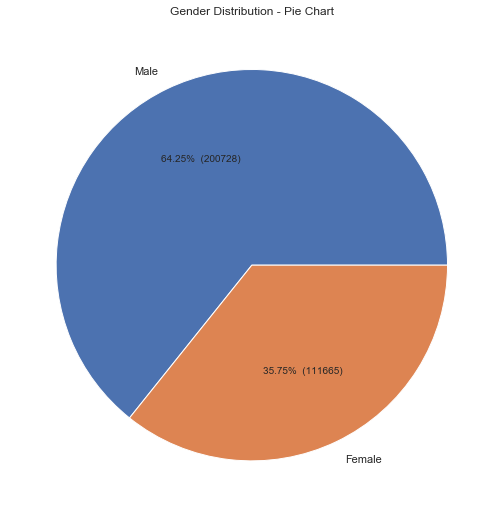

In [137]:
axis1 = plt.subplots(1,1,figsize=(15,9))
values=df_final['gender'].value_counts()
print(values)

def make_autopct(values):
    def my_autopct(pct):
        total = sum(values)
        val = int(round(pct*total/100.0))
        return '{p:.2f}%  ({v:d})'.format(p=pct,v=val)
    return my_autopct
# Using matplotlib pie chart and label the pie chart
plt.pie(values,labels=['Male','Female'], autopct=make_autopct(values));
plt.title("Gender Distribution - Pie Chart")

Text(0.5, 1, 'Gender Vs Age Distribution')

<Figure size 1080x360 with 0 Axes>

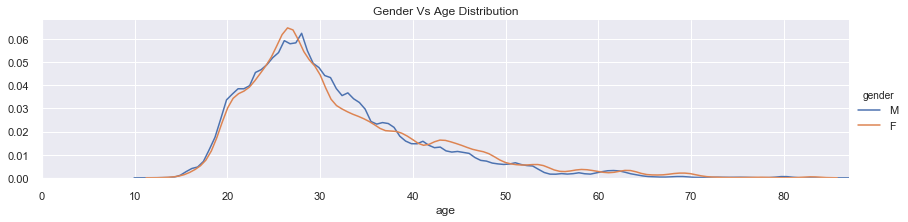

In [138]:
plt.figure(figsize=(15,5))
facet = sns.FacetGrid(df_final, hue="gender",aspect=4, hue_order=['M', 'F'])
facet.map(sns.kdeplot,'age')
facet.set(xlim=(0, df_final['age'].max()))
facet.add_legend()
plt.title("Gender Vs Age Distribution")

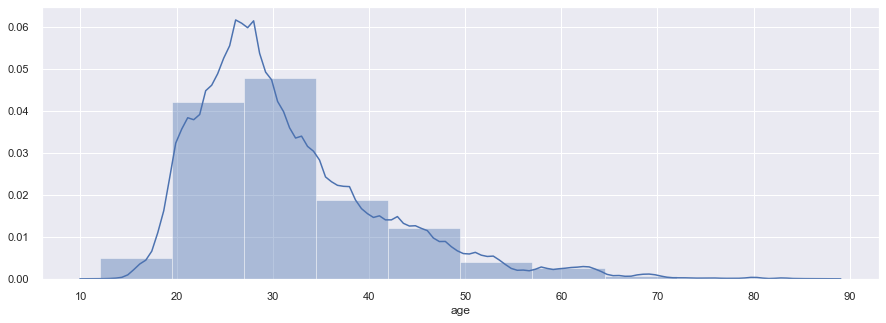

In [139]:
plt.figure(figsize=(15,5))
sns.distplot(df_final["age"],bins=10,kde=True)

Text(0.5, 1, 'Age distribution Across States')

<Figure size 1080x360 with 0 Axes>

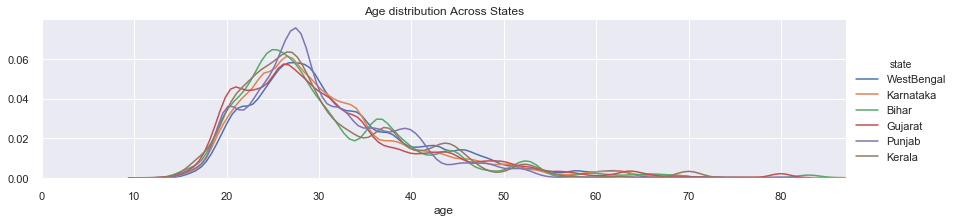

In [140]:
plt.figure(figsize=(15,5))
facet = sns.FacetGrid(df_final, hue="state",aspect=4, hue_order=['WestBengal', 'Karnataka', 'Bihar', 'Gujarat', 'Punjab', 'Kerala'])
facet.map(sns.kdeplot,'age') 
facet.set(xlim=(0, df_final['age'].max()))
facet.add_legend()
plt.title("Age distribution Across States")

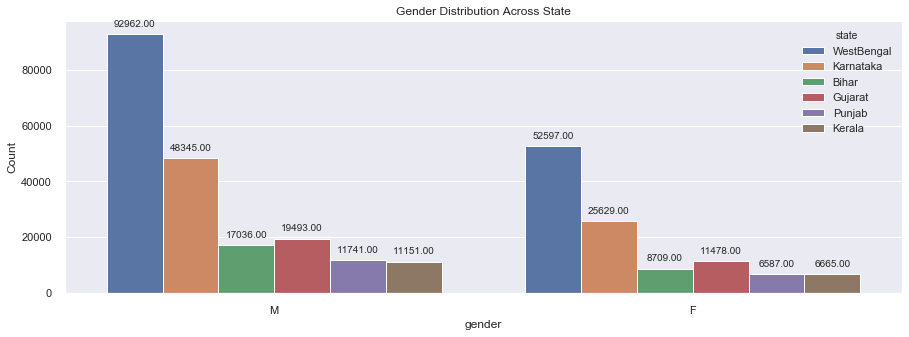

In [141]:
total = len(df_final['gender'])*1.
fig, axis1 = plt.subplots(1,1,figsize=(15,5))
splot = sns.countplot(x='gender', hue="state", data=df_final, ax=axis1)
plt.title("Gender Distribution Across State")
plt.ylabel('Count')
for p in splot.patches:
    splot.annotate(format(p.get_height(), '.2f'), (p.get_x() + p.get_width() / 2., p.get_height()), ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')


Text(0.5, 1.0, 'Age Vs Gender Distribution')

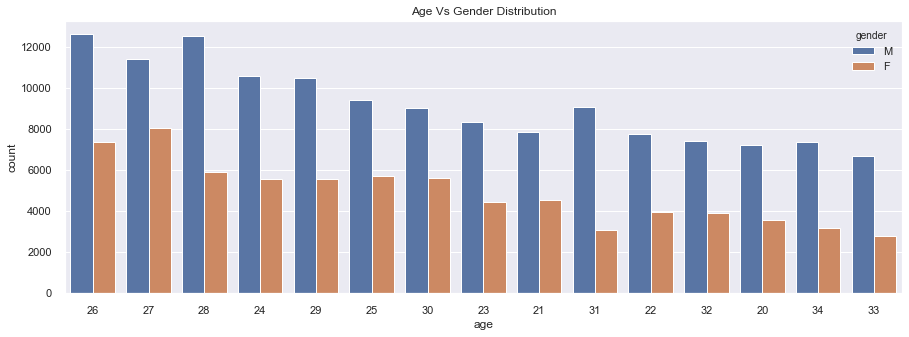

In [142]:
fig, axis1 = plt.subplots(1,1,figsize=(15,5))
sns.countplot(x='age', hue="gender", order=df_final.age.value_counts().iloc[:15].index, data=df_final, ax=axis1)
plt.title("Age Vs Gender Distribution")

Text(0.5, 1, 'Overall Gender Distribution Across States')

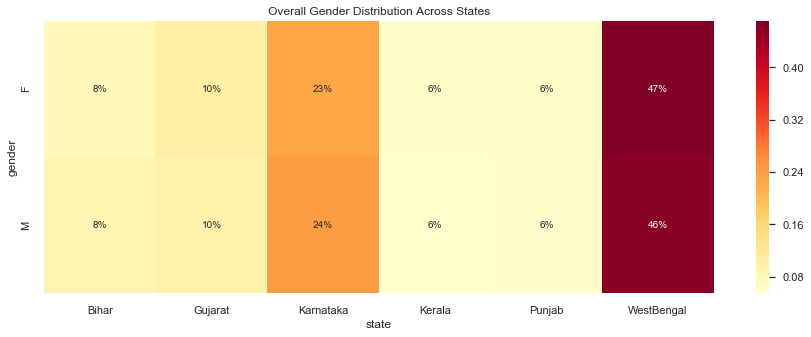

In [143]:
plt.figure(figsize=(15,5))
role_ed_xtab = pd.crosstab(df_final['gender'], df_final['state'], normalize='index')
sns.heatmap(role_ed_xtab, annot=True, fmt='0.0%', cmap='YlOrRd')
plt.title("Overall Gender Distribution Across States")

Text(0.5, 1, 'Age Group Distribution Across States')

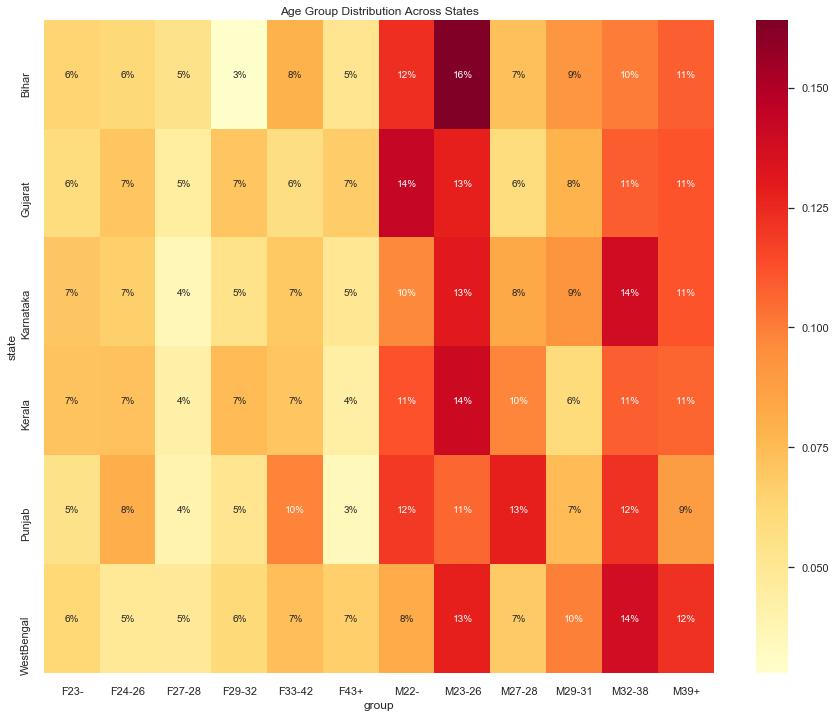

In [144]:
plt.figure(figsize=(15,12))
role_ed_xtab = pd.crosstab(df_final['state'], df_final['group'], normalize='index')
sns.heatmap(role_ed_xtab, annot=True, fmt='0.0%', cmap='YlOrRd')
plt.title("Age Group Distribution Across States")

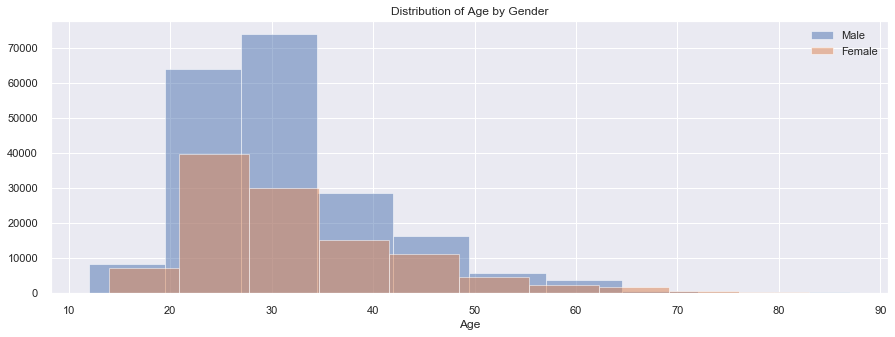

In [145]:
plt.figure(figsize=(15,5))
plt.hist('age', data=df_final[df_final['gender'] == 'M'], alpha=0.5, label='Male');
plt.hist('age', data=df_final[df_final['gender'] == 'F'], alpha=0.5, label='Female');
plt.title('Distribution of Age by Gender');
plt.xlabel('Age');
plt.legend();

<a id=section403></a>
### 4.4 Distribution of Users across Age Segments

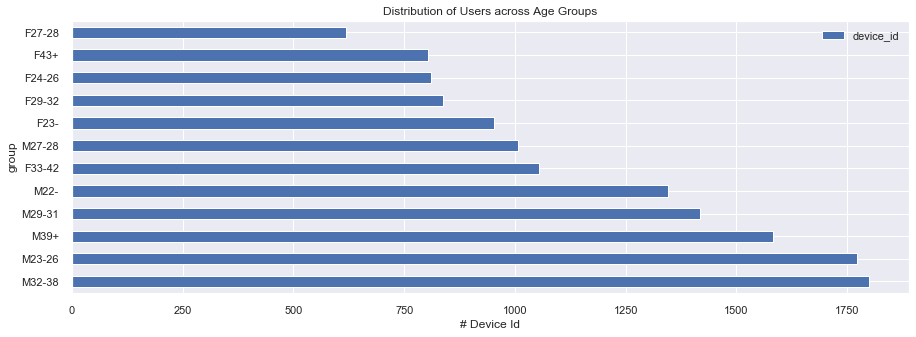

In [146]:
plt.figure(figsize=(15,5))
user_data.groupby('group').device_id.count().sort_values(ascending=False).plot(kind='barh')
plt.title('Distribution of Users across Age Groups');
plt.xlabel('# Device Id');
plt.legend();

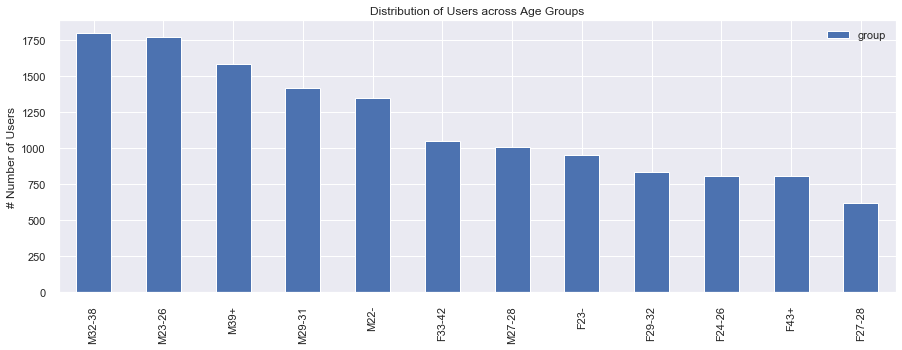

In [147]:
plt.figure(figsize=(15,5))
user_data['group'].value_counts().plot(kind='bar')
plt.title('Distribution of Users across Age Groups');
plt.ylabel('# Number of Users');
plt.legend();

In [148]:
age_group = [] 
for value in user_data['age']: 
    if value <=10: 
        age_group.append("Group-1") 
    elif value >10 and value <=20: 
        age_group.append("Group-2") 
    elif value>20 and value<=30:
        age_group.append("Group-3")
    elif value>30 and value<=40:
        age_group.append("Group-4")
    elif value>40 and value<=50:
        age_group.append("Group-5")
    elif value>50 and value<=60:
        age_group.append("Group-6")
    elif value>60 and value<=70:
        age_group.append("Group-7")
    elif value>70 and value<=80:
        age_group.append("Group-8")
    elif value>80 and value<=90:
        age_group.append("Group-9")
    else: 
        age_group.append("Group-10") 
        
user_data['age_group'] = age_group  

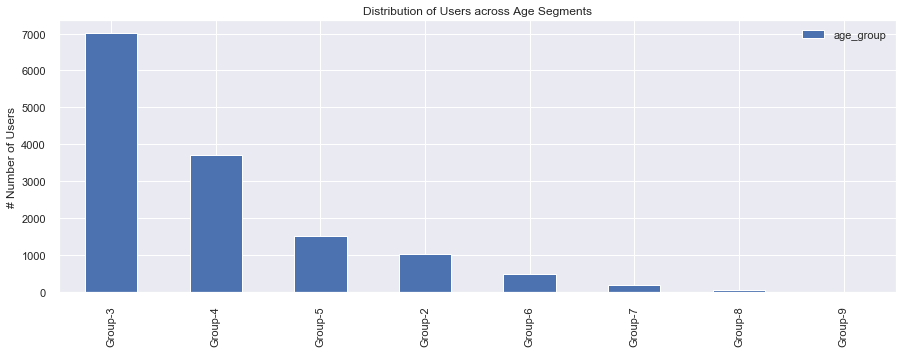

In [149]:
plt.figure(figsize=(15,5))
user_data['age_group'].value_counts().plot.bar()
plt.title('Distribution of Users across Age Segments');
plt.ylabel('# Number of Users');
plt.legend();

Text(0.5, 1.0, 'Age Group Distribution Across States')

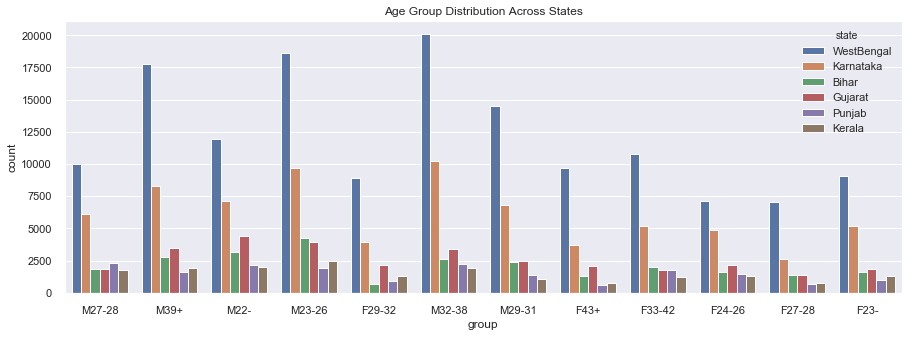

In [150]:
fig, axis1 = plt.subplots(1,1,figsize=(15,5))
sns.countplot(x='group', hue="state", data=df_final, ax=axis1)
plt.title("Age Group Distribution Across States")

In [151]:
df_WestBengal = df_final[df_final.state=='WestBengal']
df_Karnataka = df_final[df_final.state=='Karnataka']
df_Gujarat = df_final[df_final.state=='Gujarat']
df_Bihar = df_final[df_final.state=='Bihar']
df_Punjab = df_final[df_final.state=='Punjab']
df_Kerala = df_final[df_final.state=='Kerala']

<a id=section404></a>
### 4.5 Distribution of Phone Brands(10 Most used Phone Brand): Age Segment, State, Gender

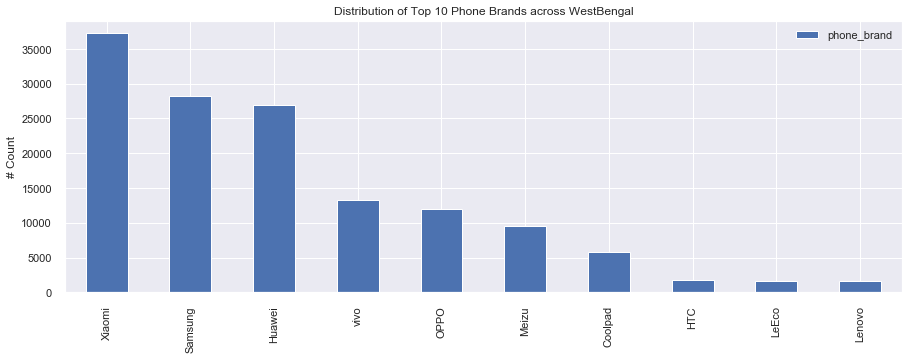

In [152]:
plt.figure(figsize=(15,5))
df_WestBengal['phone_brand'].value_counts().head(10).plot.bar()
plt.title('Distribution of Top 10 Phone Brands across WestBengal');
plt.ylabel('# Count');
plt.legend();

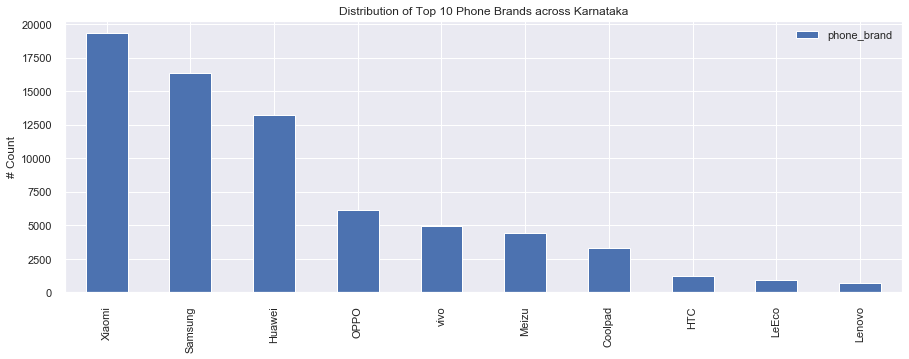

In [153]:
plt.figure(figsize=(15,5))
df_Karnataka['phone_brand'].value_counts().head(10).plot.bar()
plt.title('Distribution of Top 10 Phone Brands across Karnataka');
plt.ylabel('# Count');
plt.legend();

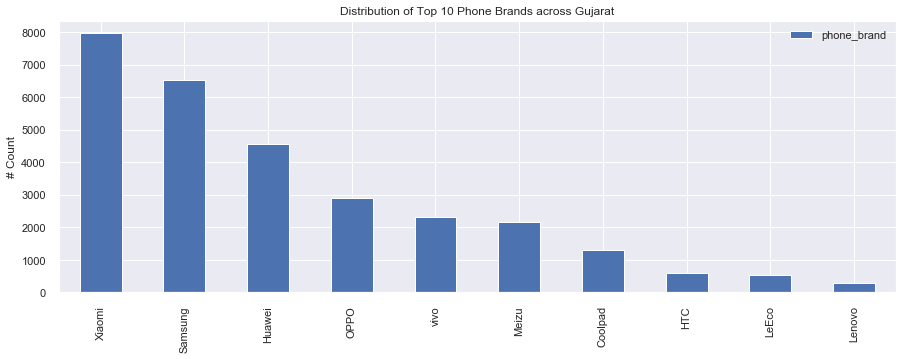

In [154]:
plt.figure(figsize=(15,5))
df_Gujarat['phone_brand'].value_counts().head(10).plot.bar()
plt.title('Distribution of Top 10 Phone Brands across Gujarat');
plt.ylabel('# Count');
plt.legend();

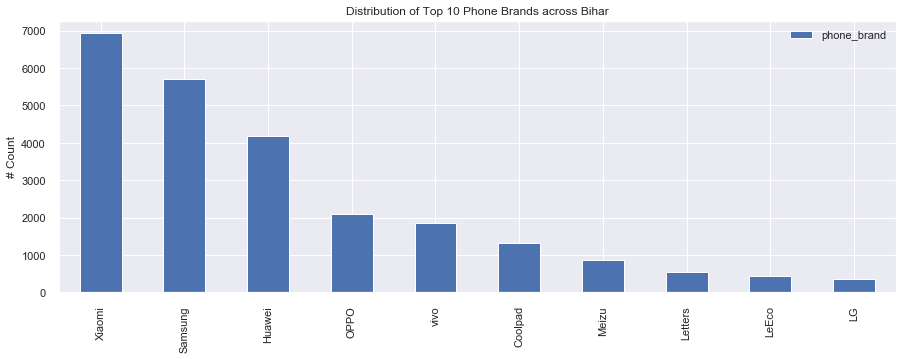

In [155]:
plt.figure(figsize=(15,5))
df_Bihar['phone_brand'].value_counts().head(10).plot.bar()
plt.title('Distribution of Top 10 Phone Brands across Bihar');
plt.ylabel('# Count');
plt.legend();

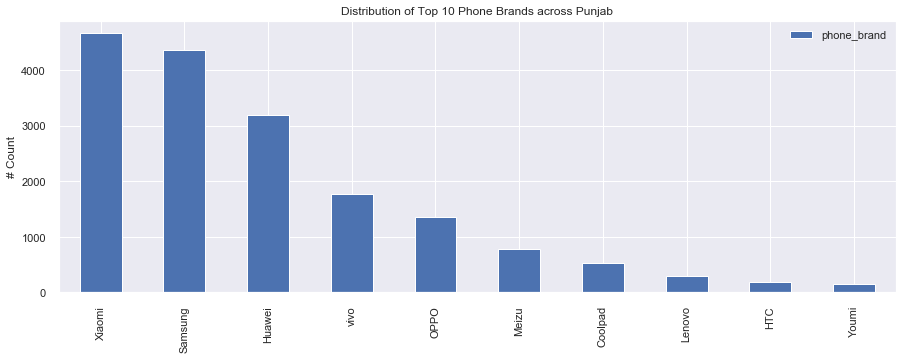

In [156]:
plt.figure(figsize=(15,5))
df_Punjab['phone_brand'].value_counts().head(10).plot.bar()
plt.title('Distribution of Top 10 Phone Brands across Punjab');
plt.ylabel('# Count');
plt.legend();

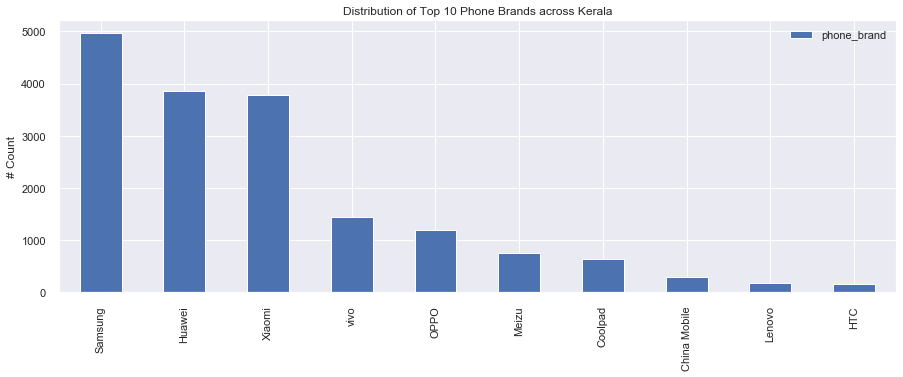

In [157]:
plt.figure(figsize=(15,5))
df_Kerala['phone_brand'].value_counts().head(10).plot.bar()
plt.title('Distribution of Top 10 Phone Brands across Kerala');
plt.ylabel('# Count');
plt.legend();

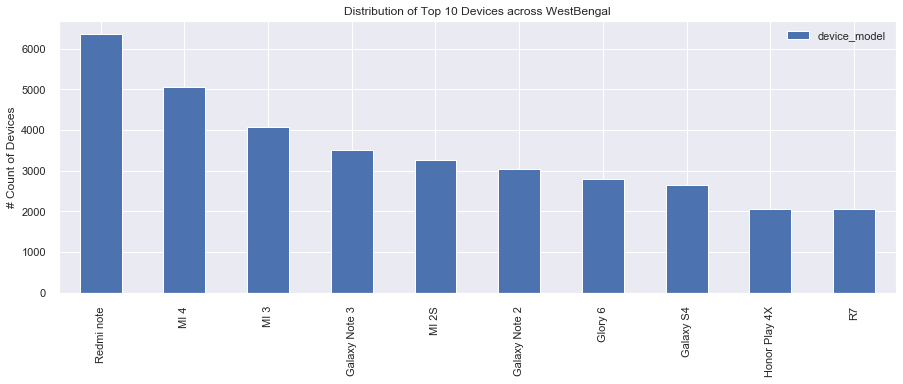

In [158]:
plt.figure(figsize=(15,5))
df_WestBengal['device_model'].value_counts().head(10).plot.bar()
plt.title('Distribution of Top 10 Devices across WestBengal');
plt.ylabel('# Count of Devices');
plt.legend();

/Users/pratikajitb/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 23567 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/pratikajitb/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 31859 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/pratikajitb/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 23567 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/pratikajitb/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 31859 missing from current font.
  font.set_text(s, 0, flags=flags)


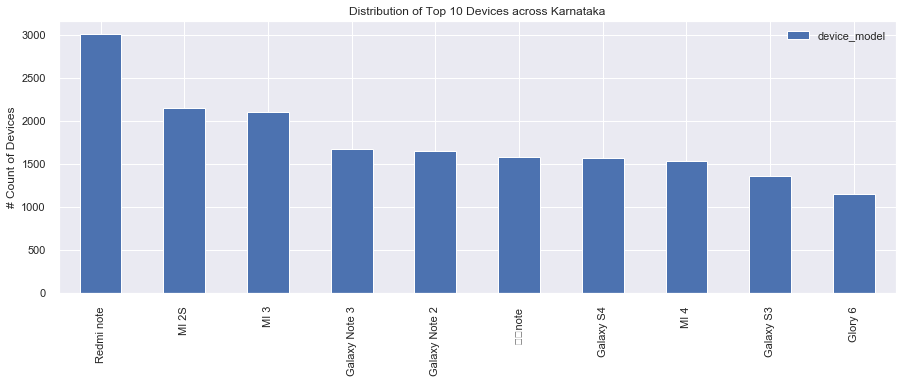

In [159]:
plt.figure(figsize=(15,5))
df_Karnataka['device_model'].value_counts().head(10).plot.bar()
plt.title('Distribution of Top 10 Devices across Karnataka');
plt.ylabel('# Count of Devices');
plt.legend();

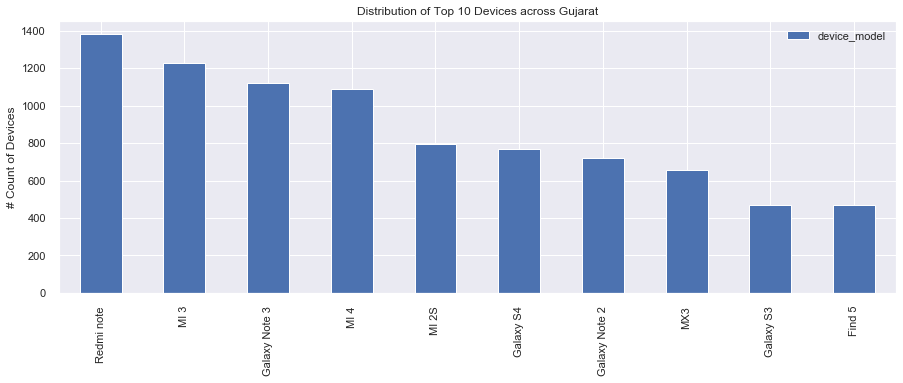

In [160]:
plt.figure(figsize=(15,5))
df_Gujarat['device_model'].value_counts().head(10).plot.bar()
plt.title('Distribution of Top 10 Devices across Gujarat');
plt.ylabel('# Count of Devices');
plt.legend();

/Users/pratikajitb/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 32418 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/pratikajitb/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 31859 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/pratikajitb/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 23567 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/pratikajitb/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 36771 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/pratikajitb/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 26898 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/pratikajitb/anaconda3/lib/python3.7/site-package

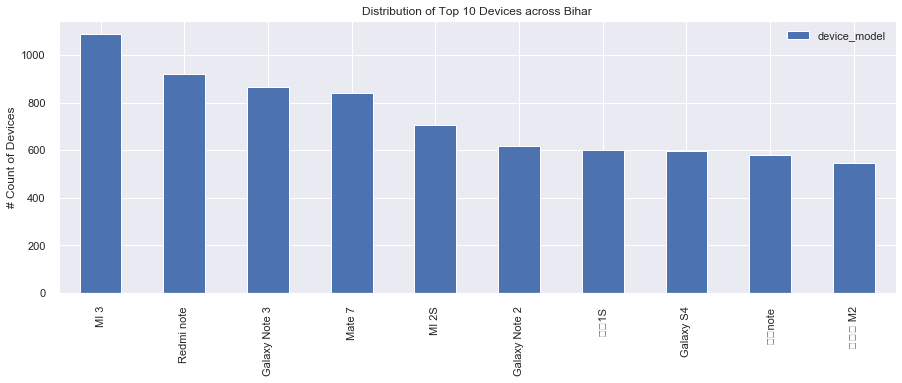

In [161]:
plt.figure(figsize=(15,5))
df_Bihar['device_model'].value_counts().head(10).plot.bar()
plt.title('Distribution of Top 10 Devices across Bihar');
plt.ylabel('# Count of Devices');
plt.legend();

/Users/pratikajitb/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 32418 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/pratikajitb/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 31859 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/pratikajitb/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 32418 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/pratikajitb/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 31859 missing from current font.
  font.set_text(s, 0, flags=flags)


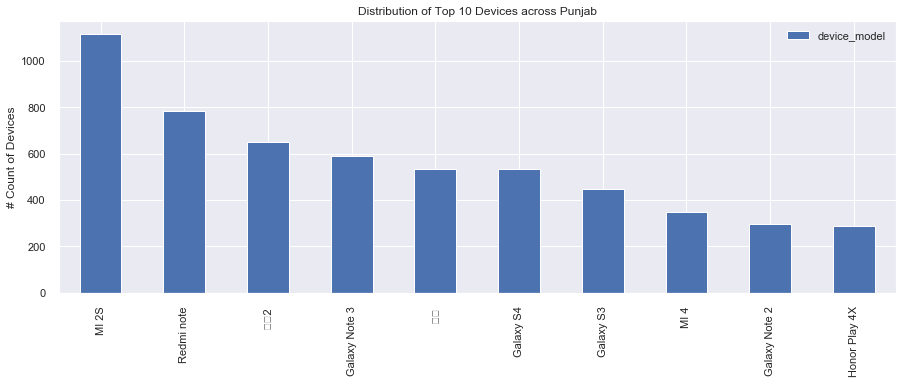

In [162]:
plt.figure(figsize=(15,5))
df_Punjab['device_model'].value_counts().head(10).plot.bar()
plt.title('Distribution of Top 10 Devices across Punjab');
plt.ylabel('# Count of Devices');
plt.legend();

/Users/pratikajitb/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 32418 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/pratikajitb/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:211: RuntimeWarning: Glyph 31859 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/pratikajitb/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 32418 missing from current font.
  font.set_text(s, 0, flags=flags)
/Users/pratikajitb/anaconda3/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:180: RuntimeWarning: Glyph 31859 missing from current font.
  font.set_text(s, 0, flags=flags)


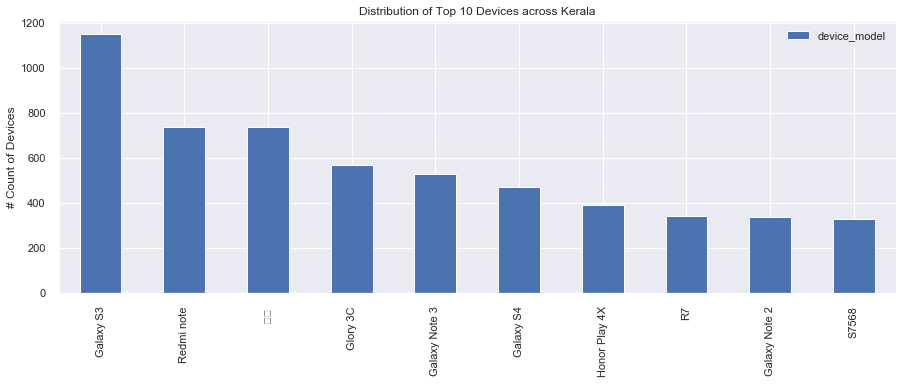

In [163]:
plt.figure(figsize=(15,5))
df_Kerala['device_model'].value_counts().head(10).plot.bar()
plt.title('Distribution of Top 10 Devices across Kerala');
plt.ylabel('# Count of Devices');
plt.legend();

Text(0.5, 1.0, 'Top 10 Phone Brand Distribution Across States')

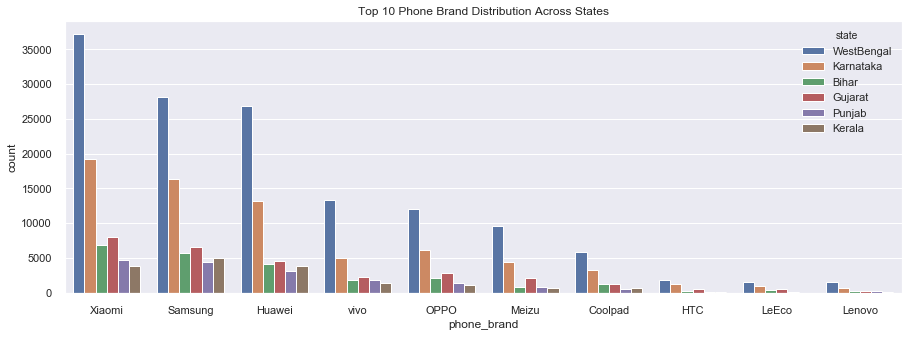

In [164]:
fig, axis1 = plt.subplots(1,1,figsize=(15,5))
sns.countplot(x='phone_brand', hue="state",order=df_final.phone_brand.value_counts().iloc[:10].index, data=df_final, ax=axis1)
plt.title("Top 10 Phone Brand Distribution Across States")

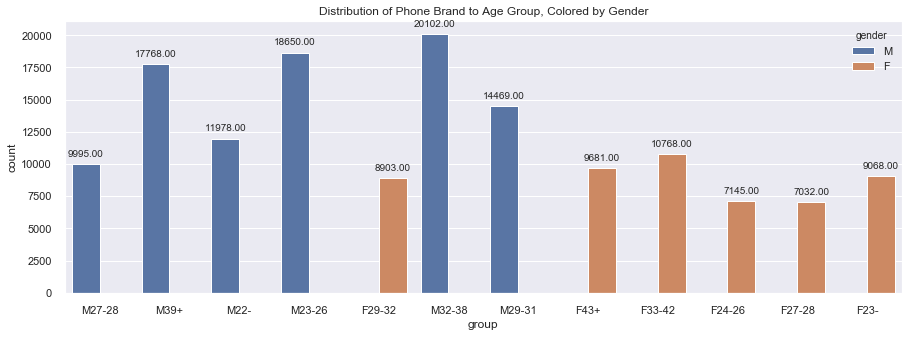

In [165]:
fig, axis1 = plt.subplots(1,1,figsize=(15,5))
splot = sns.countplot('group', hue='gender', data=df_WestBengal);
plt.title('Distribution of Phone Brand to Age Group, Colored by Gender');
for p in splot.patches:
    splot.annotate(format(p.get_height(), '.2f'), (p.get_x() + p.get_width() / 2., p.get_height()), \
                   ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')

<a id=section405></a>
### 4.6 Distribution of Gender for each State, Age Segment and Phone Brand(10 Most used Phone Brands)

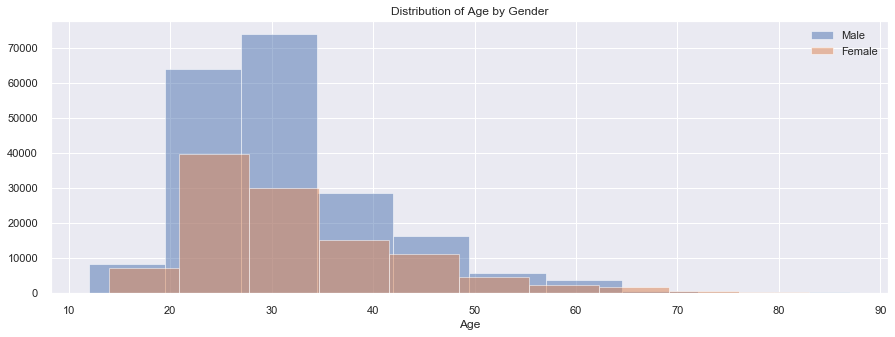

In [166]:
plt.figure(figsize=(15,5))
plt.hist('age', data=df_final[df_final['gender'] == 'M'], alpha=0.5, label='Male');
plt.hist('age', data=df_final[df_final['gender'] == 'F'], alpha=0.5, label='Female');
plt.title('Distribution of Age by Gender');
plt.xlabel('Age');
plt.legend();

/Users/pratikajitb/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:9: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  if __name__ == '__main__':


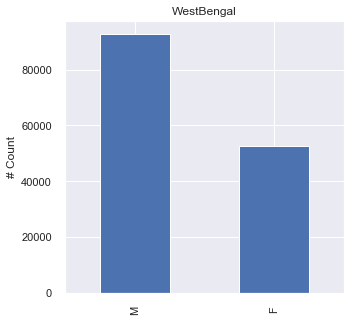

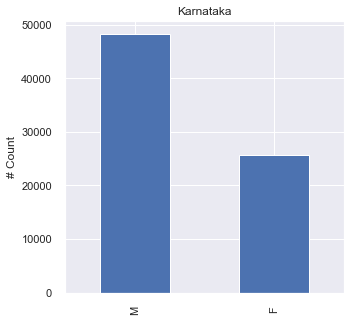

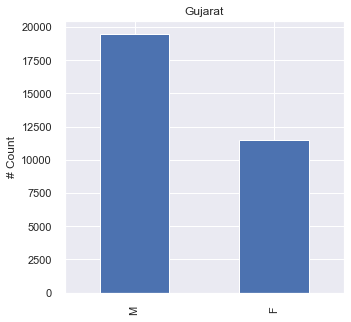

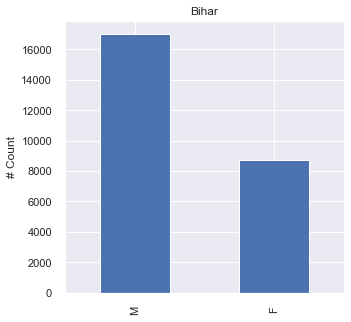

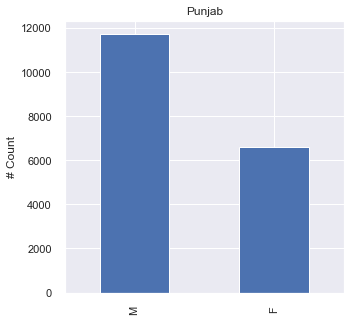

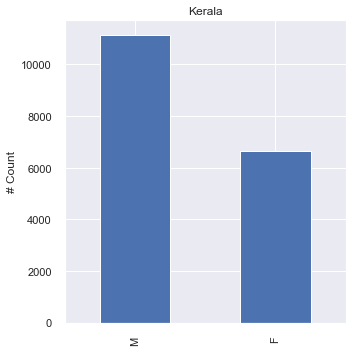

In [167]:
states = ['WestBengal', 'Karnataka', 'Gujarat', 'Bihar', 'Punjab', 'Kerala']

for state in states:
    fig, axes = plt.subplots(figsize=(5,5))
    df_final[df_final['state']==state]['gender'].value_counts().head().plot.bar()
    plt.title(state)
    plt.ylabel('# Count')
fig.tight_layout()
fig.show()    

<a id=section406></a>
### 4.7 Distribution of Age Segments for each State, Gender and Phone Brand(10 Most used Phone Brands)

In [168]:
df_final['state'].value_counts()

WestBengal    145559
Karnataka      73974
Gujarat        30971
Bihar          25745
Punjab         18328
Kerala         17816
Name: state, dtype: int64

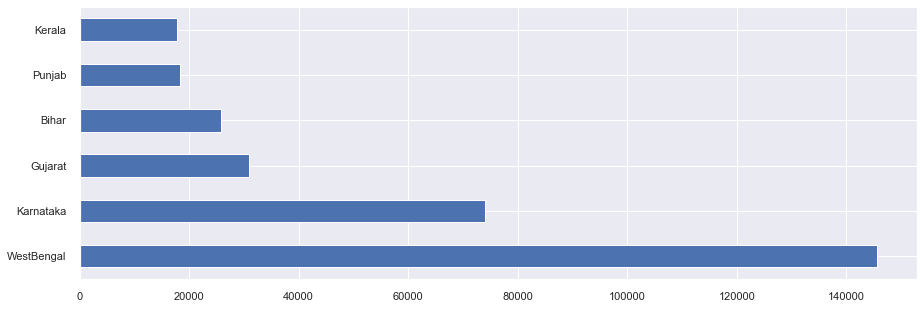

In [169]:
plt.figure(figsize=(15,5))
df_final['state'].value_counts().plot.barh()

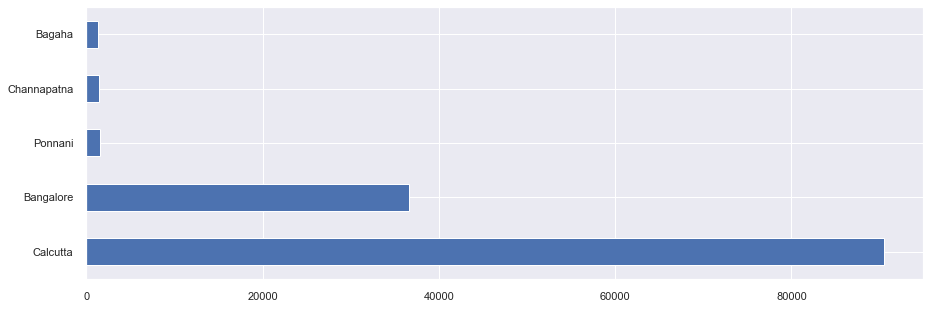

In [170]:
plt.figure(figsize=(15,5))
df_final['city'].value_counts().head().plot.barh()

Text(0.5, 1.0, 'Top 10 Phone Brand Distribution Across States')

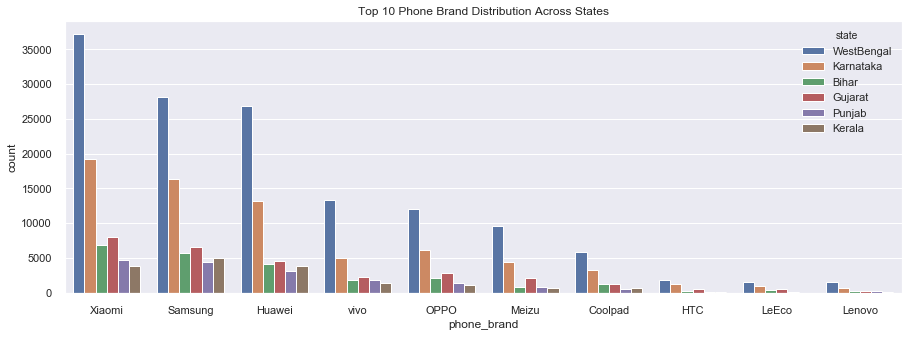

In [171]:
fig, axis1 = plt.subplots(1,1,figsize=(15,5))
sns.countplot(x='phone_brand', hue="state",order=df_final.phone_brand.value_counts().iloc[:10].index, data=df_final, ax=axis1)
plt.title("Top 10 Phone Brand Distribution Across States")

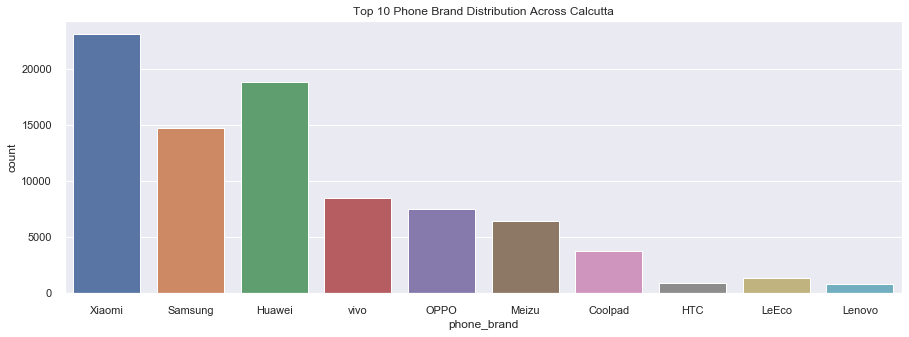

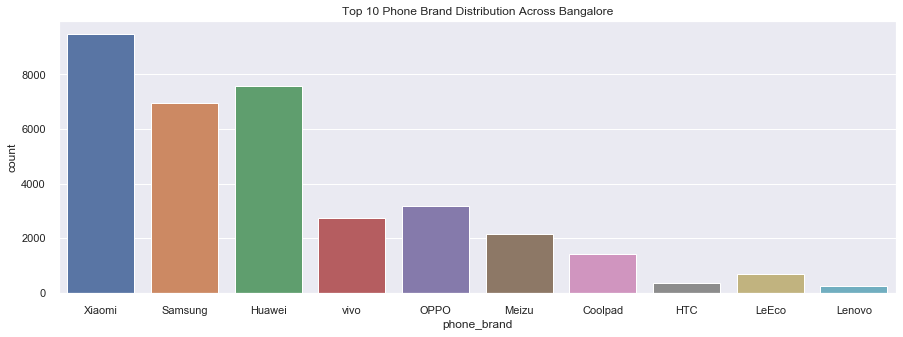

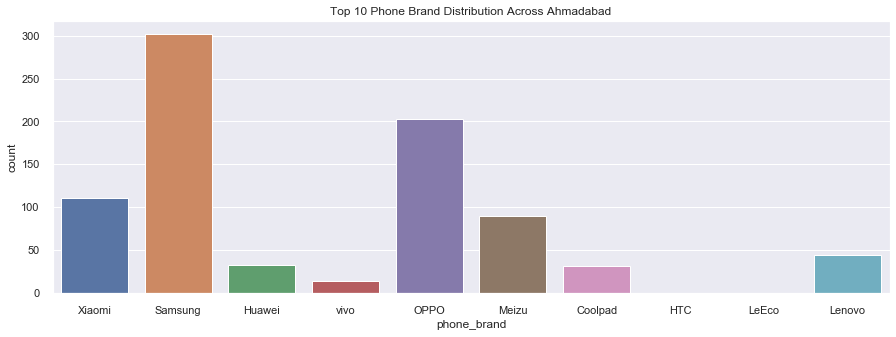

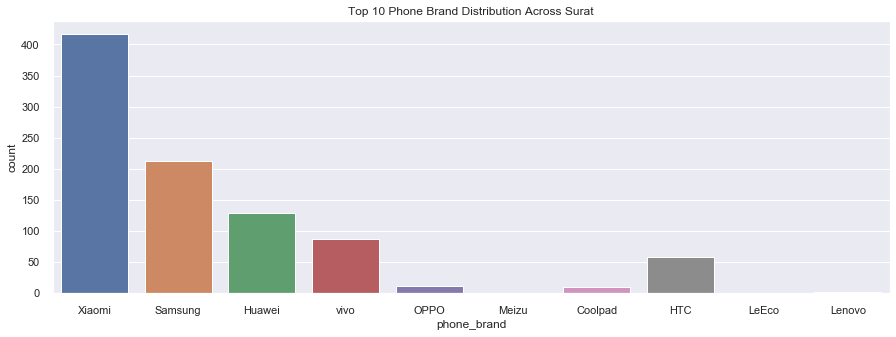

In [172]:
list_metro_cities = ['Calcutta', 'Bangalore', 'Ahmadabad', 'Surat']
for i in list_metro_cities:
    #print (i)
    #print (df_final[df_final['city']==i]['device_model'].value_counts().head(10))
    fig, axis1 = plt.subplots(1,1,figsize=(15,5))
    sns.countplot(x='phone_brand' ,order=df_final.phone_brand.value_counts().iloc[:10].index, data=df_final[df_final['city']==i], ax=axis1)
    plt.title("Top 10 Phone Brand Distribution Across " + i)
    

In [173]:
metro_city_data = df_final[df_final.city.isin(list_metro_cities)]

In [174]:
metro_city_data.groupby(['gender','city'])['city'].count()


gender  city     
F       Ahmadabad      344
        Bangalore    12647
        Calcutta     30809
        Surat          539
M       Ahmadabad      483
        Bangalore    23962
        Calcutta     59642
        Surat          629
Name: city, dtype: int64

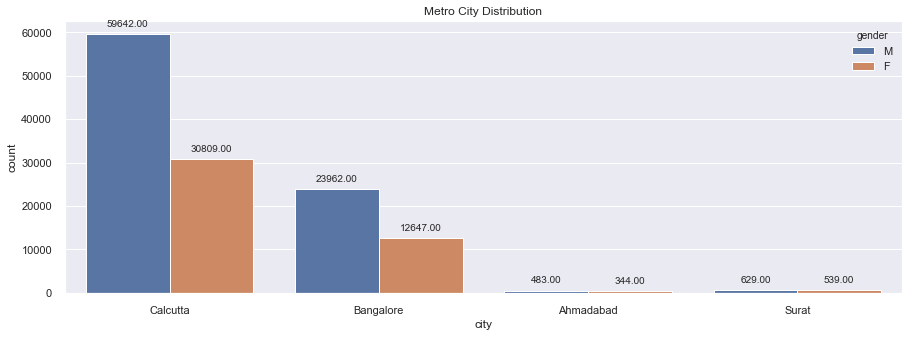

In [175]:
fig, axis1 = plt.subplots(1,1,figsize=(15,5))
splot = sns.countplot(x='city', hue='gender', data=metro_city_data, ax=axis1)
plt.title("Metro City Distribution")
for p in splot.patches:
    splot.annotate(format(p.get_height(), '.2f'), (p.get_x() + p.get_width() / 2., p.get_height()), \
                   ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')

Text(0.5, 1, 'Age distribution Across Metro city Data')

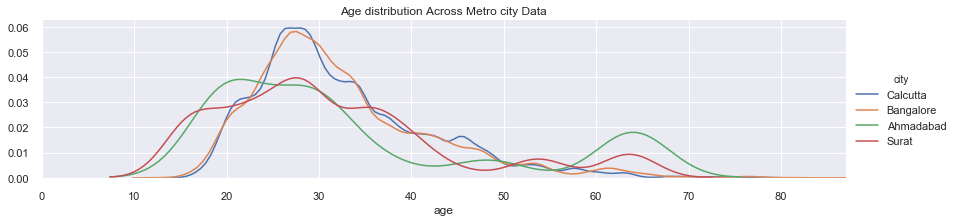

In [176]:
facet = sns.FacetGrid(metro_city_data, hue="city",aspect=4, hue_order=['Calcutta', 'Bangalore', 'Ahmadabad', 'Surat'])
facet.map(sns.kdeplot,'age') 
facet.set(xlim=(0, metro_city_data['age'].max()))
facet.add_legend()
plt.title("Age distribution Across Metro city Data")

In [177]:
non_metro_city_data = df_final[~df_final['city'].isin(list_metro_cities)]

In [178]:
non_metro_city_data['city'].value_counts().head(7)

Ponnani         1481
Channapatna     1437
Bagaha          1298
Dinapur         1263
Bankura         1251
Krishnanagar    1219
Jetpur          1218
Name: city, dtype: int64

Text(0.5, 1, 'Age distribution Across Non Metro city Data')

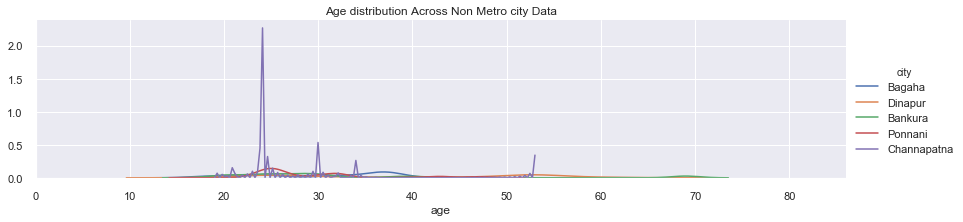

In [179]:
facet = sns.FacetGrid(non_metro_city_data, hue="city",aspect=4, hue_order=['Bagaha','Dinapur','Bankura','Ponnani','Channapatna'])
facet.map(sns.kdeplot,'age') 
facet.set(xlim=(0, non_metro_city_data['age'].max()))
facet.add_legend()
plt.title("Age distribution Across Non Metro city Data")

In [180]:
df_final.columns

Index(['event_id', 'device_id', 'timestamp', 'longitude', 'latitude', 'city',
       'state', 'phone_brand', 'device_model', 'gender', 'age', 'group'],
      dtype='object')

In [181]:
x = df_final['phone_brand'].value_counts().head(10)
x

Xiaomi     79843
Samsung    66158
Huawei     55838
vivo       25649
OPPO       25642
Meizu      18461
Coolpad    12876
HTC         4246
LeEco       3668
Lenovo      3266
Name: phone_brand, dtype: int64

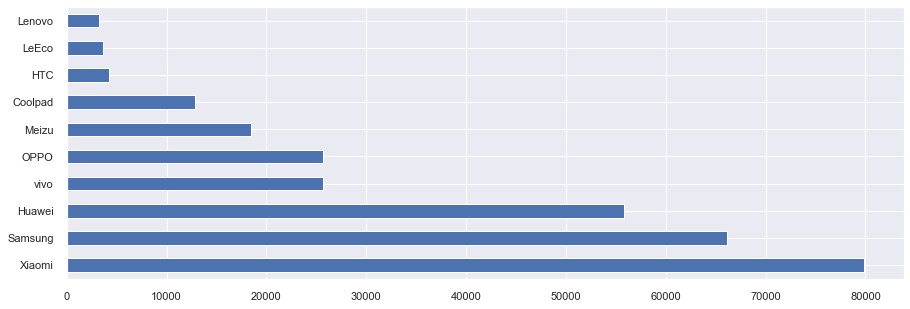

In [182]:
fig, axis1 = plt.subplots(1,1,figsize=(15,5))
x.plot(kind='barh')
plt.show()

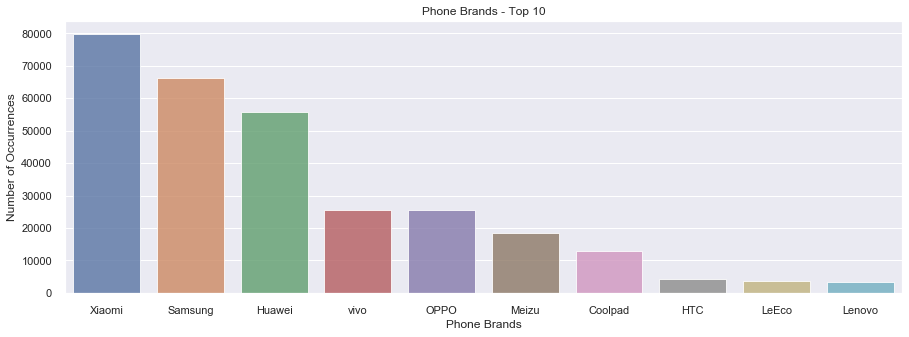

In [183]:
brand_count  = df_final['phone_brand'].value_counts()
brand_count = brand_count[:10,]
plt.figure(figsize=(15,5))
sns.barplot(brand_count.index, brand_count.values, alpha=0.8)
plt.title('Phone Brands - Top 10')
plt.ylabel('Number of Occurrences', fontsize=12)
plt.xlabel('Phone Brands', fontsize=12)
plt.show()

In [184]:
df_final['group'].value_counts().head(10)

M23-26    40973
M32-38    40505
M39+      35816
M22-      30935
M29-31    28577
M27-28    23922
F33-42    22804
F23-      20012
F24-26    18588
F43+      18243
Name: group, dtype: int64

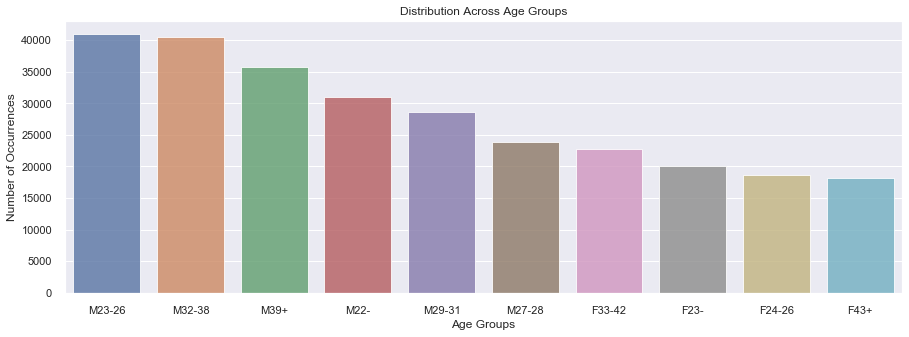

In [185]:
group_count  = df_final['group'].value_counts()
group_count = group_count[:10,]
plt.figure(figsize=(15,5))
sns.barplot(group_count.index, group_count.values, alpha=0.8)
plt.title('Distribution Across Age Groups')
plt.ylabel('Number of Occurrences', fontsize=12)
plt.xlabel('Age Groups', fontsize=12)
plt.show()

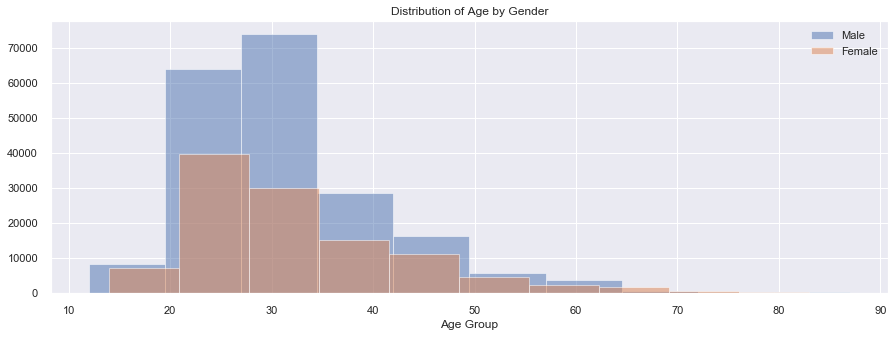

In [186]:
plt.figure(figsize=(15,5))
plt.hist('age', data=df_final[df_final['gender'] == 'M'], alpha=0.5, label='Male');
plt.hist('age', data=df_final[df_final['gender'] == 'F'], alpha=0.5, label='Female');
plt.title('Distribution of Age by Gender');
plt.xlabel('Age Group');
plt.legend();

<a id=section407></a>
### 4.8 Hourly distribution of Phone Calls

In [187]:
df_final.sample(10)

,event_id,device_id,timestamp,longitude,latitude,city,state,phone_brand,device_model,gender,age,group
265331,"804,909.0","3,502,110,609,721,942,528.0",2016-05-07 23:16:18,78.1,13.5,Chintamani,Karnataka,Samsung,Galaxy S Advance,F,21,F23-
21897,"90,050.0","636,960,401,289,772,416.0",2016-05-02 10:25:25,88.5,22.7,Calcutta,WestBengal,Huawei,Ascend P6,F,19,F23-
180316,"2,835,228.0","-518,155,467,507,673,600.0",2016-05-02 18:19:15,73.4,23.5,Modasa,Gujarat,Xiaomi,MI 2A,M,21,M22-
87387,"2,645,951.0","7,644,826,784,213,520,384.0",2016-05-07 09:43:15,88.4,22.6,Calcutta,WestBengal,vivo,X3T,F,32,F29-32
248147,"164,537.0","-7,888,115,427,616,437,248.0",2016-05-06 05:12:23,88.8,26.6,Jalpaiguri,WestBengal,Samsung,Galaxy Core Max,M,27,M27-28
280283,"2,418,609.0","4,141,821,309,125,274,624.0",2016-05-07 07:09:05,88.4,22.8,Titagarh,WestBengal,Huawei,Honor 6 Plus,F,31,F29-32
103263,"302,215.0","-7,114,450,614,836,300,800.0",2016-05-02 10:30:34,77.6,13.1,Bangalore,Karnataka,Meizu,MX3,F,27,F27-28
97923,"1,943,280.0","5,671,407,521,231,319,040.0",2016-05-02 19:36:20,77.6,13.1,Bangalore,Karnataka,OPPO,U707T,F,23,F23-
220067,"2,172,158.0","-1,390,425,861,935,064,320.0",2016-05-01 00:03:32,85.9,25.5,Mokama,Bihar,OPPO,R7,F,20,F23-
253480,"732,371.0","-6,267,914,363,605,864,448.0",2016-05-07 10:49:28,77.0,13.8,Sira,Karnataka,Samsung,Galaxy Note 3,M,52,M39+


In [188]:
df_final['timestamp'] = pd.to_datetime(df_final['timestamp'])

In [189]:
df_final['date'] = pd.to_datetime(df_final['timestamp']).dt.date
df_final['time'] = pd.to_datetime(df_final['timestamp']).dt.time
df_final['date'] = pd.to_datetime(df_final['date'])
df_final['day'] = pd.to_datetime(df_final['timestamp']).dt.weekday_name
df_final['month']= pd.to_datetime(df_final['timestamp']).dt.month

In [190]:
def finding_time_range(val):
    if(val >= time(8,0) and val < time(12,0)):
        return '08 to 12'
    elif(val >= time(12,0) and val < time(16,0)):
        return '12 to 16'
    elif(val >= time(16,0) and val < time(20,0)):
        return '16 to 20'
    elif(val >= time(20,0) and val < time(23,59)):
        return '20 to 00'
    elif(val >= time(0,0) and val < time(4,0)):
        return '00 to 04'
    elif(val >= time(4,0) and val < time(8,0)):
        return '04 to 08'


In [191]:
df_final['timestamp'].sample(10)

294637   2016-05-02 09:36:35
78685    2016-05-06 21:04:56
224832   2016-05-04 20:01:34
138862   2016-05-05 22:35:43
307076   2016-05-01 15:30:23
169196   2016-05-03 22:17:39
33235    2016-05-01 15:38:08
172123   2016-05-02 18:45:57
239577   2016-05-04 10:28:26
45993    2016-05-03 14:39:01
Name: timestamp, dtype: datetime64[ns]

In [192]:
df_final.head(3)

,event_id,device_id,timestamp,longitude,latitude,city,state,phone_brand,device_model,gender,age,group,date,time,day,month
0,"74,778.0","6,173,131,034,529,612,800.0",2016-05-01 08:02:02,88.4,22.7,Calcutta,WestBengal,vivo,X5V,M,28,M27-28,2016-05-01,08:02:02,Sunday,5
1,"527,238.0","6,173,131,034,529,612,800.0",2016-05-02 21:03:22,88.4,22.7,Calcutta,WestBengal,vivo,X5V,M,28,M27-28,2016-05-02,21:03:22,Monday,5
2,"1,264,753.0","6,173,131,034,529,612,800.0",2016-05-06 21:36:26,88.4,22.7,Calcutta,WestBengal,vivo,X5V,M,28,M27-28,2016-05-06,21:36:26,Friday,5


In [193]:
df_final['time_range'] = df_final['timestamp'].dt.hour

<Figure size 1080x360 with 0 Axes>

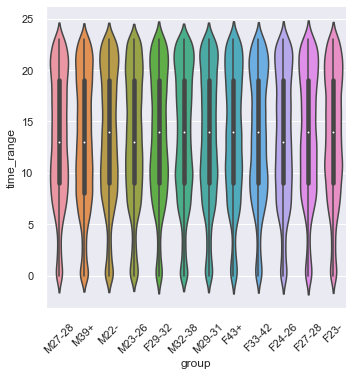

In [194]:
plt.figure(figsize=(15,5))
g = sns.catplot(x="group", y='time_range', kind="violin", data=df_final)
g.set_xticklabels(rotation=45)

<a id=section408></a>
### 4.9 Users on the Map using any suitable package

In [195]:
map2 = folium.Map(location=[22.356359, 79.395484], zoom_start=5)
mc2 = MarkerCluster()
state_list = ['WestBengal', 'Karnataka', 'Gujarat', 'Bihar', 'Punjab', 'Kerala']

for state in state_list:
    mapping_data = df_events_data[['latitude', 'longitude','city']][df_events_data['state']==state].drop_duplicates()
    citylist = mapping_data['city'].tolist()
        
    locations = mapping_data[['latitude', 'longitude']]
    locationlist = locations.values.tolist()
    
    for index, item in enumerate(locationlist):
        mc2.add_child(folium.Marker(location=item, popup=citylist[index]))
                             
map2.add_child(mc2)
map2.save("state_wise_map_plot2.html")
map2

## Hourly distribution of phonecalls by age group for Male

<Figure size 1080x360 with 0 Axes>

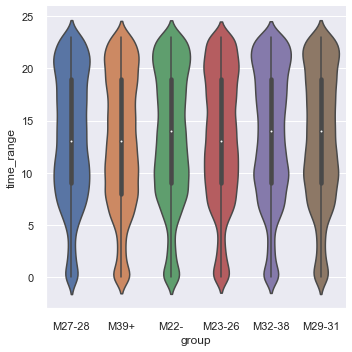

In [196]:
plt.figure(figsize=(15,5))
sns.catplot(x="group", y='time_range', kind="violin", data=df_final[df_final['gender']=='M'])

## Hourly distribution of phonecalls by age group for Female

<Figure size 1080x360 with 0 Axes>

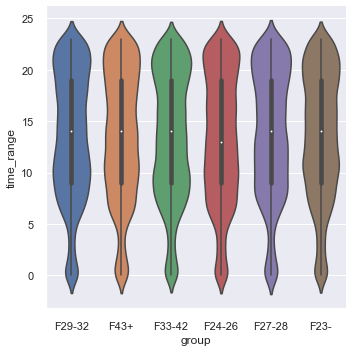

In [197]:
plt.figure(figsize=(15,5))
sns.catplot(x="group", y='time_range', kind="violin", data=df_final[df_final['gender']=='F'])

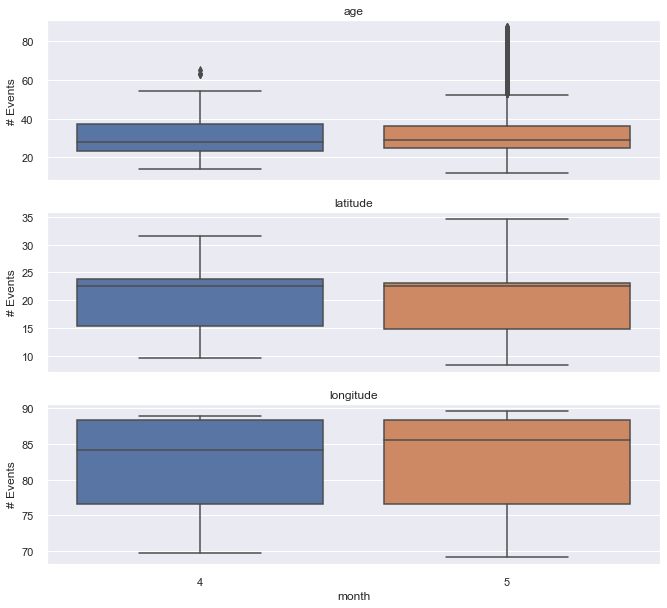

In [198]:
fig, axes = plt.subplots(3, 1, figsize=(11, 10), sharex=True)
for name, ax in zip(["age", "latitude", "longitude"], axes):
    sns.boxplot(data=df_final, x='month', y=name, ax=ax)
    ax.set_ylabel('# Events')
    ax.set_title(name)
    # Remove the automatic x-axis label from all but the bottom subplot
    if ax != axes[-1]:
        ax.set_xlabel('')

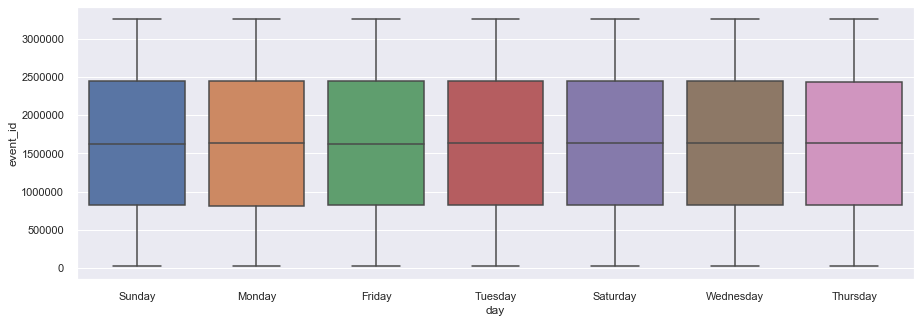

In [199]:
plt.figure(figsize=(15,5))
sns.boxplot(data=df_final, x='day', y='event_id');

Text(0.5, 1.0, 'Age Distribution')

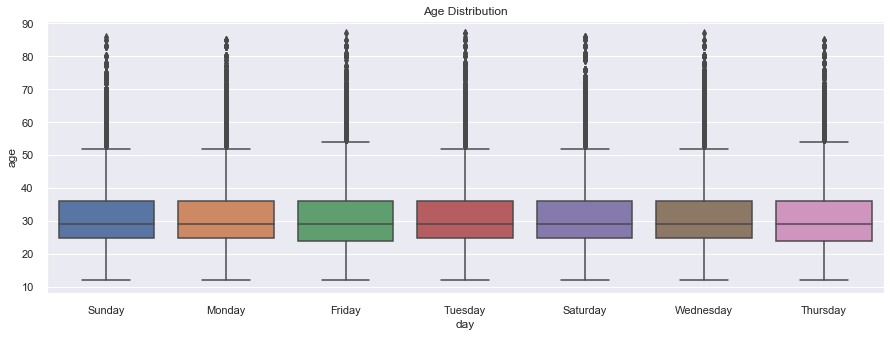

In [200]:
plt.figure(figsize=(15,5))
sns.boxplot(data=df_final, x='day', y='age');
plt.title("Age Distribution")

Text(0, 0.5, '# Event Count')

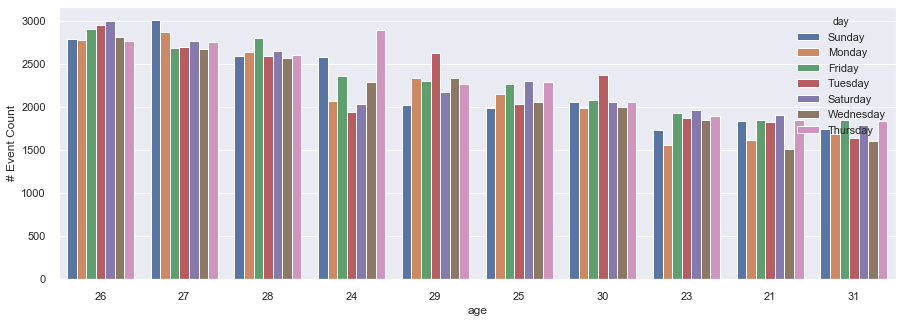

In [201]:
plt.figure(figsize=(15,5))
sns.countplot(data=df_final, x='age',hue='day', order=df_final.age.value_counts().iloc[:10].index )
plt.ylabel('# Event Count')

## Statewise distribution of calls

<Figure size 1080x360 with 0 Axes>

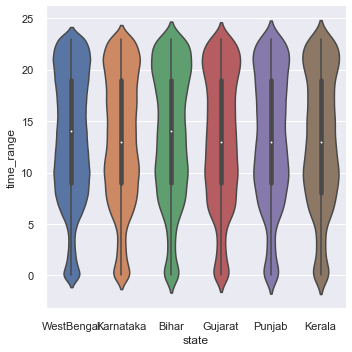

In [202]:
plt.figure(figsize=(15,5))
sns.catplot(x="state", y='time_range', kind="violin", data=df_final)

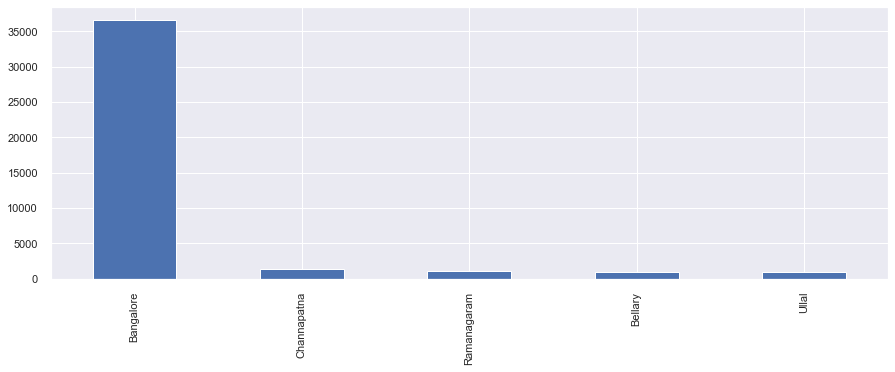

In [203]:
plt.figure(figsize=(15,5))
df_final[df_final['state']=='Karnataka']['city'].value_counts().head().plot.bar()

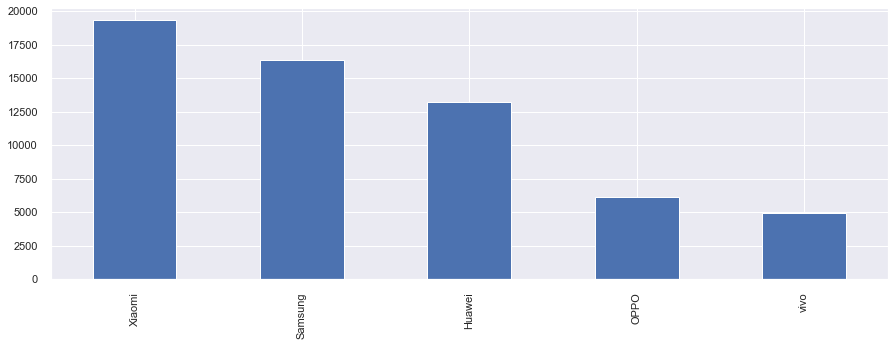

In [204]:
plt.figure(figsize=(15,5))
df_final[df_final['state']=='Karnataka']['phone_brand'].value_counts().head().plot.bar()

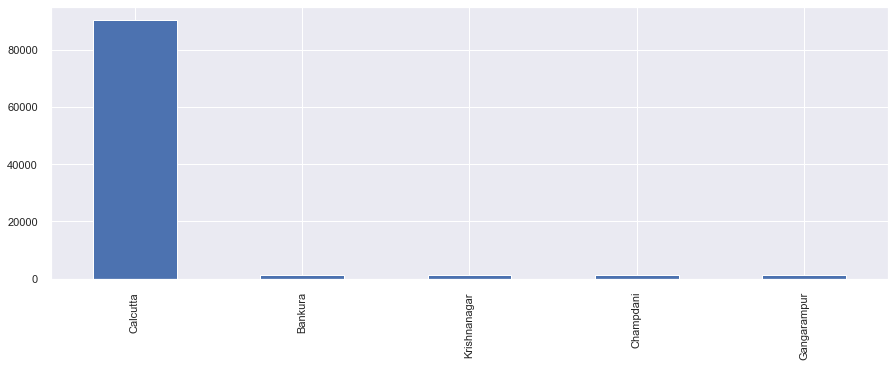

In [205]:
plt.figure(figsize=(15,5))
df_final[df_final['state']=='WestBengal']['city'].value_counts().head().plot.bar()

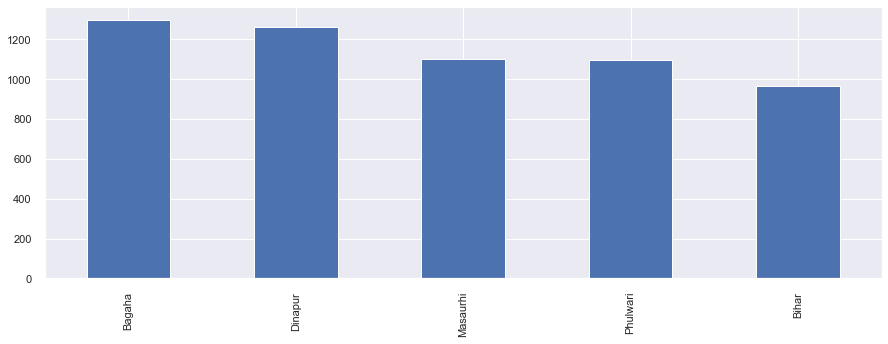

In [206]:
plt.figure(figsize=(15,5))
df_final[df_final['state']=='Bihar']['city'].value_counts().head().plot.bar()

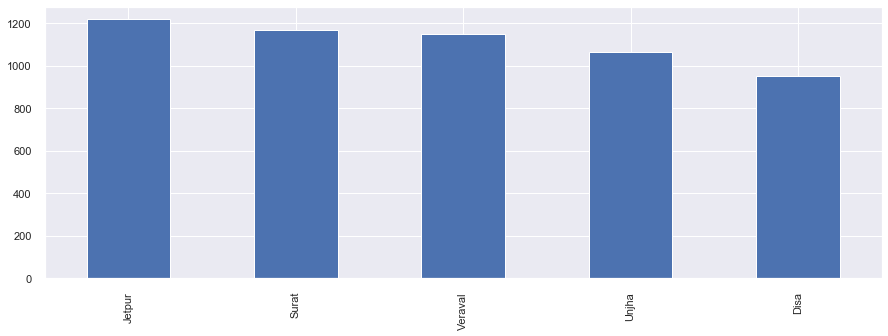

In [207]:
plt.figure(figsize=(15,5))
df_final[df_final['state']=='Gujarat']['city'].value_counts().head().plot.bar()

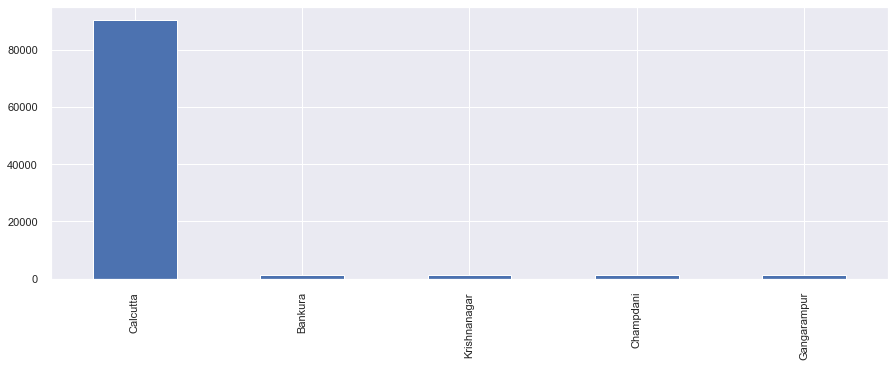

In [208]:
plt.figure(figsize=(15,5))
df_final[df_final['state']=='WestBengal']['city'].value_counts().head().plot.bar()

/Users/pratikajitb/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


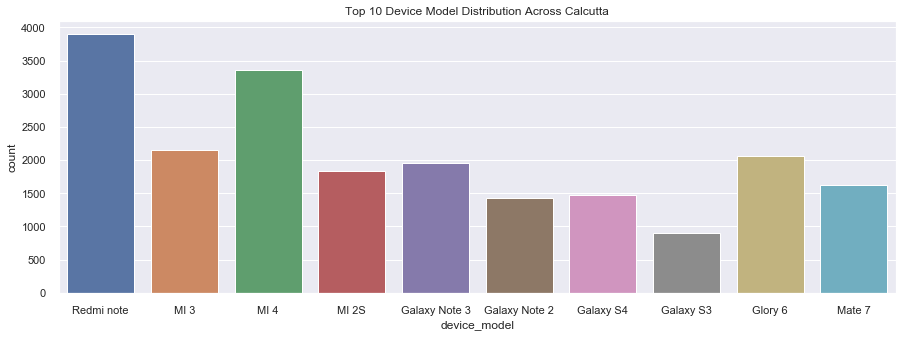

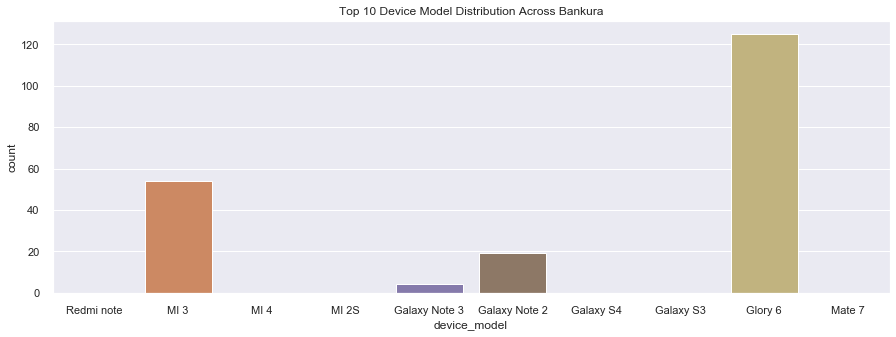

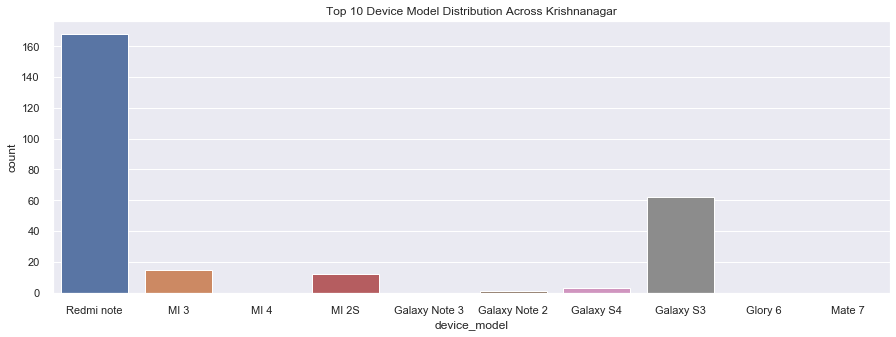

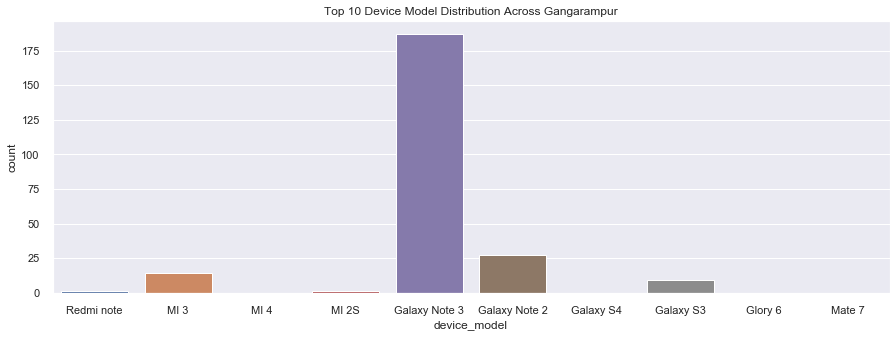

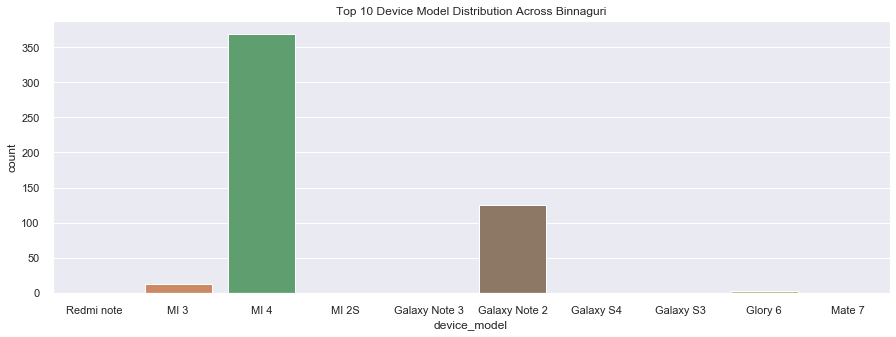

...

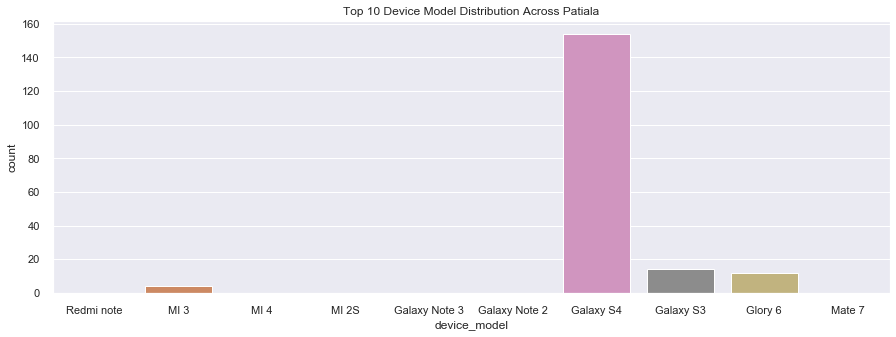

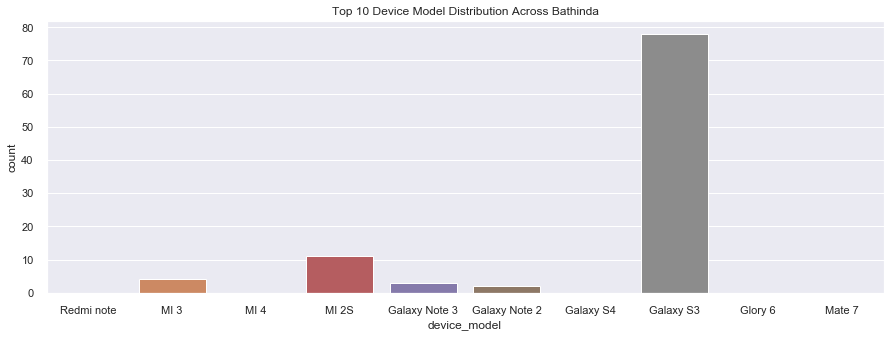

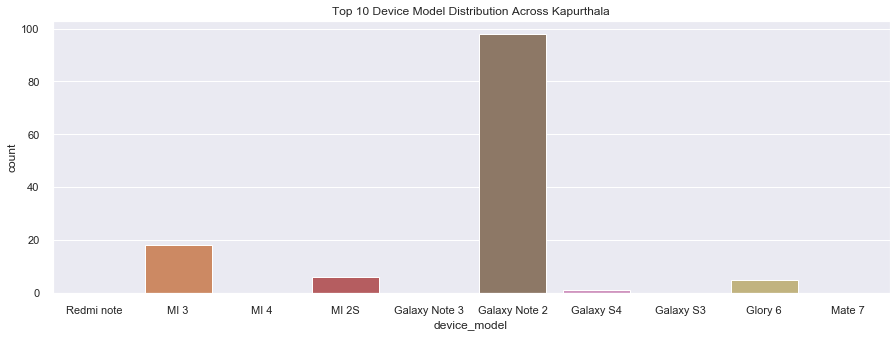

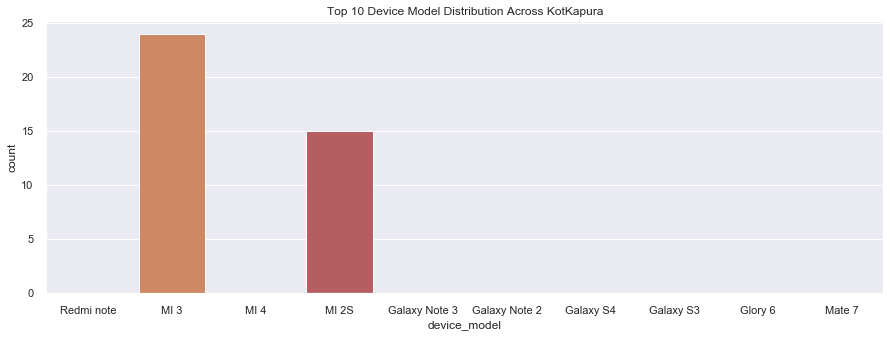

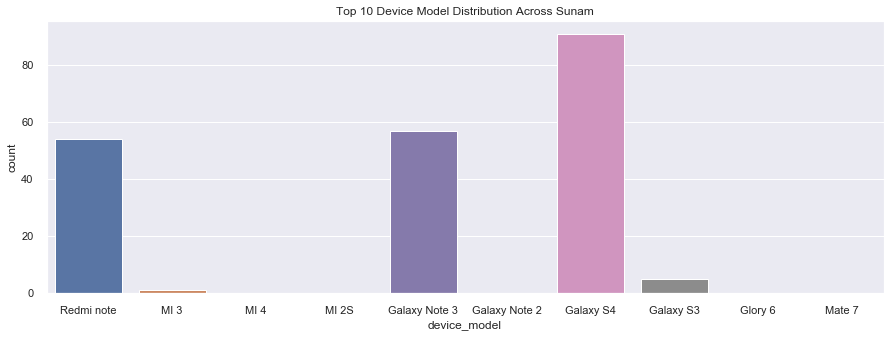

In [209]:
city = ['Calcutta','Bankura','Krishnanagar','Gangarampur','Binnaguri','Bangalore','Channapatna','Ramanagaram','Ullal','Karwar','Dinapur','Madhipura','Purnia','Masaurhi','Bihar','Jetpur','Veraval','Unjha','Surat','Gondal','Ponnani','Malappuram','Kollam','Thiruvananthapuram','Tiruvalla','Patiala','Bathinda','Kapurthala','KotKapura','Sunam']
for i in city:
    #print (i)
    #print (df_final[df_final['city']==i]['device_model'].value_counts().head(10))
    fig, axis1 = plt.subplots(1,1,figsize=(15,5))
    sns.countplot(x='device_model' ,order=df_final.device_model.value_counts().iloc[:10].index, data=df_final[df_final['city']==i], ax=axis1)
    plt.title("Top 10 Device Model Distribution Across " + i)
    

/Users/pratikajitb/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


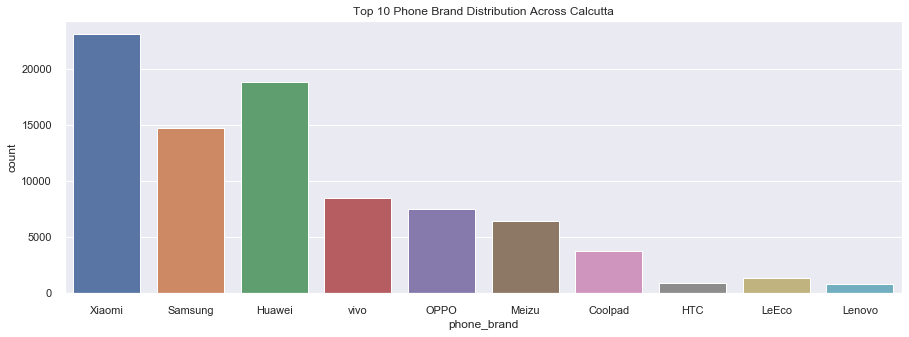

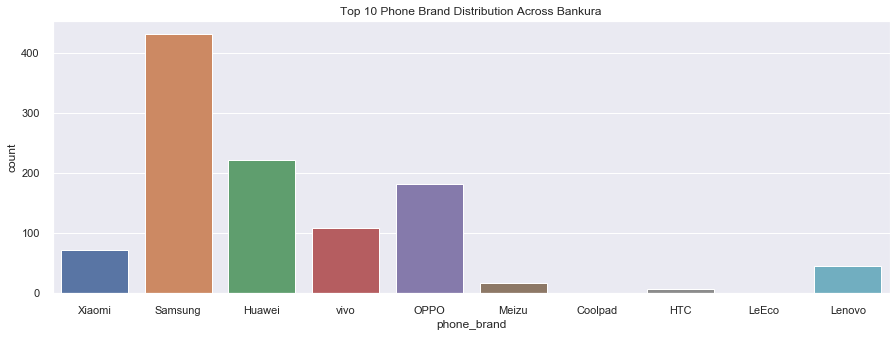

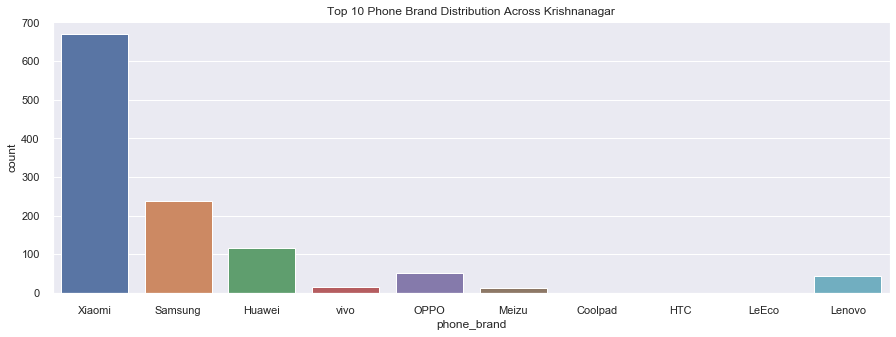

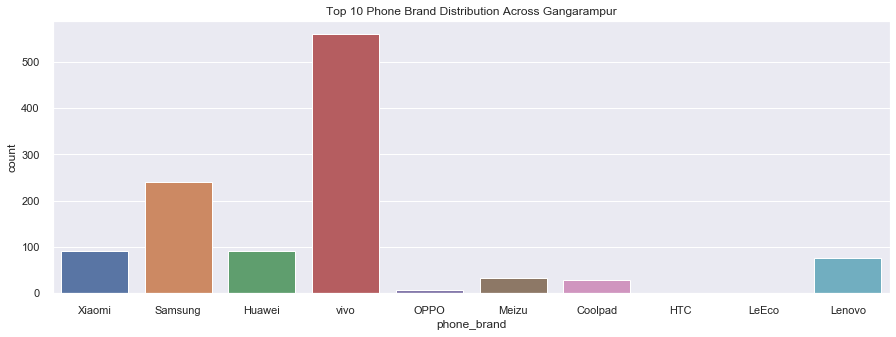

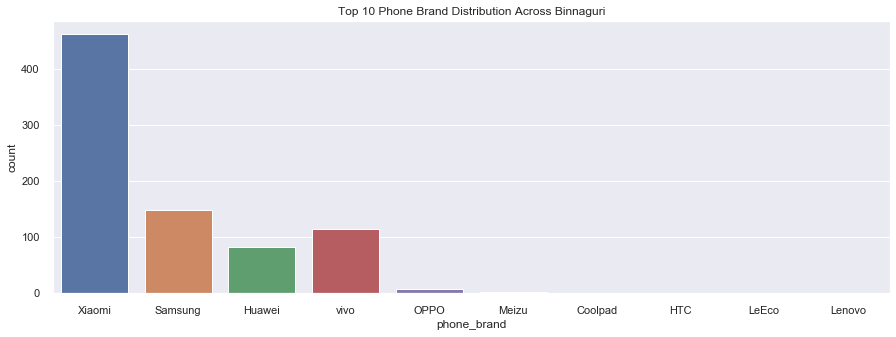

...

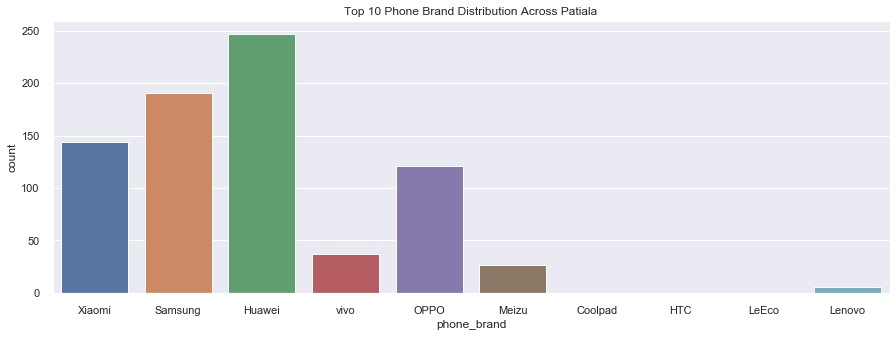

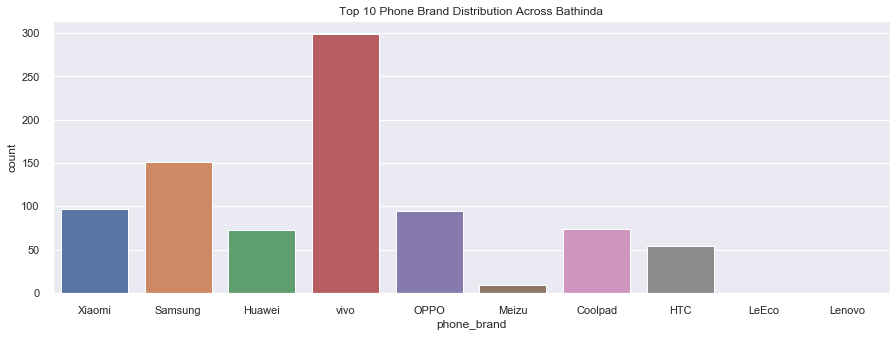

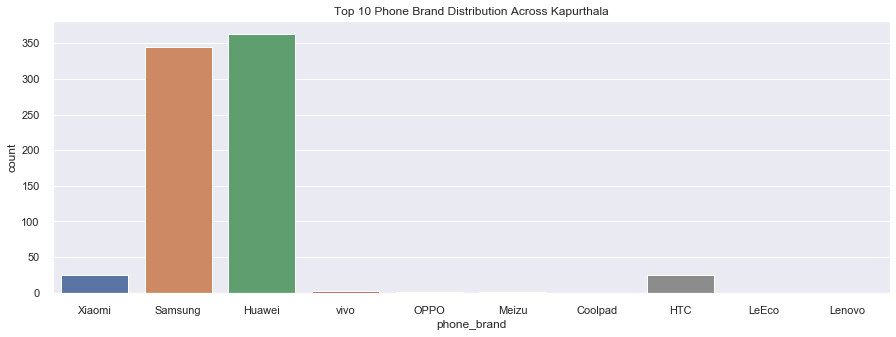

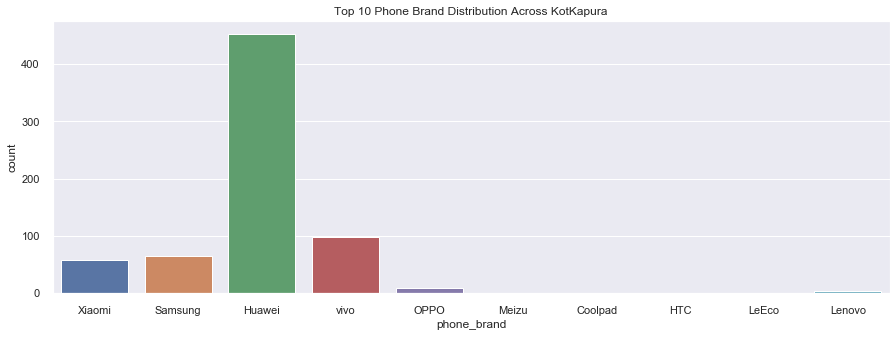

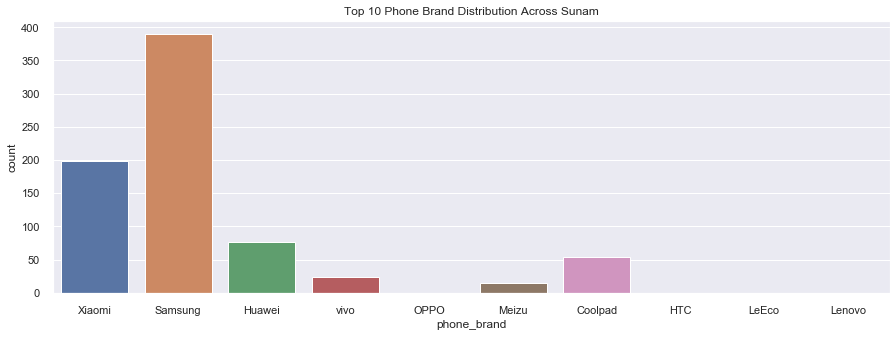

In [210]:
city = ['Calcutta','Bankura','Krishnanagar','Gangarampur','Binnaguri','Bangalore','Channapatna','Ramanagaram','Ullal','Karwar','Dinapur','Madhipura','Purnia','Masaurhi','Bihar','Jetpur','Veraval','Unjha','Surat','Gondal','Ponnani','Malappuram','Kollam','Thiruvananthapuram','Tiruvalla','Patiala','Bathinda','Kapurthala','KotKapura','Sunam']
for i in city:
    fig, axis1 = plt.subplots(1,1,figsize=(15,5))
    sns.countplot(x='phone_brand' ,order=df_final.phone_brand.value_counts().iloc[:10].index, data=df_final[df_final['city']==i], ax=axis1)
    plt.title("Top 10 Phone Brand Distribution Across " + i)
    #print (i)
    #print (df_final[df_final['city']==i]['phone_brand'].value_counts().head(10))

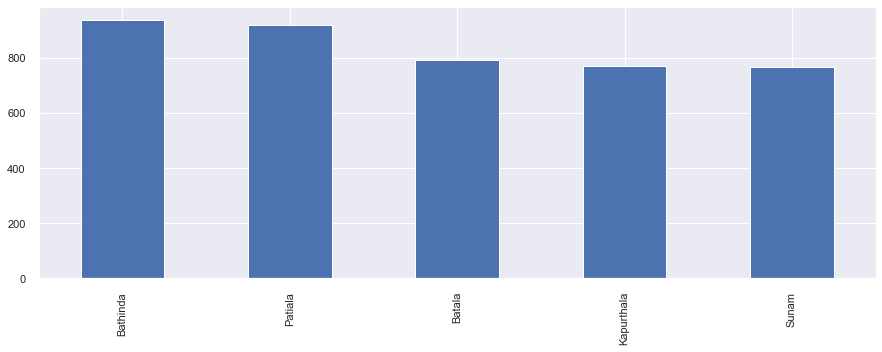

In [211]:
plt.figure(figsize=(15,5))
df_final[df_final['state']=='Punjab']['city'].value_counts().head().plot.bar()

In [212]:
df_final[df_final['state']=='Bihar']['city'].value_counts().head()

Bagaha      1298
Dinapur     1263
Masaurhi    1101
Phulwari    1096
Bihar        963
Name: city, dtype: int64

In [213]:
df_final['group'].unique()

array(['M27-28', 'M39+', 'M22-', 'M23-26', 'F29-32', 'M32-38', 'M29-31',
       'F43+', 'F33-42', 'F24-26', 'F27-28', 'F23-'], dtype=object)

### Popular phone brands among all age groups

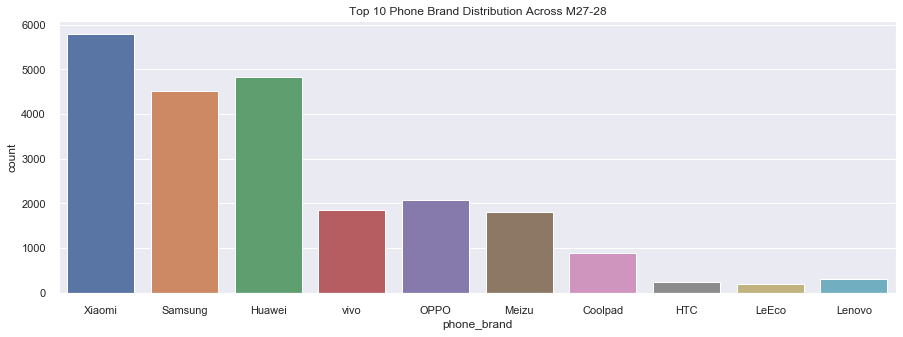

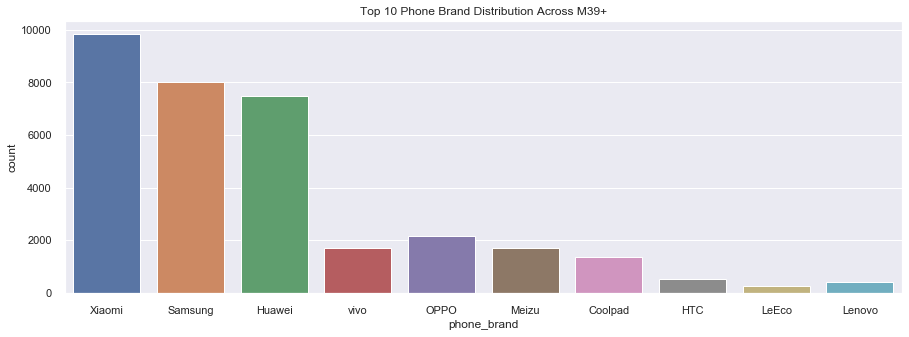

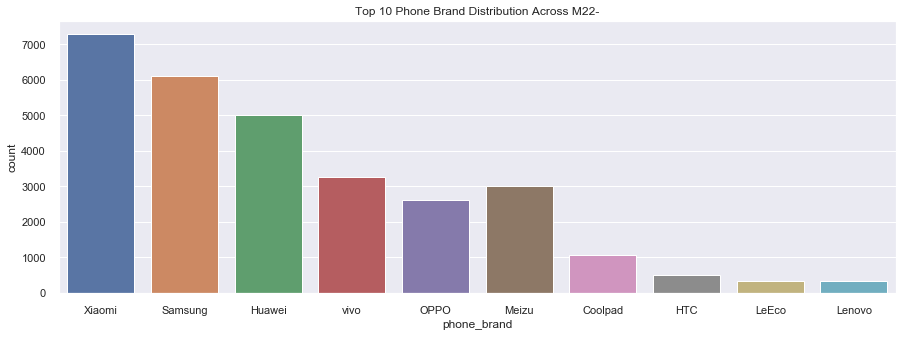

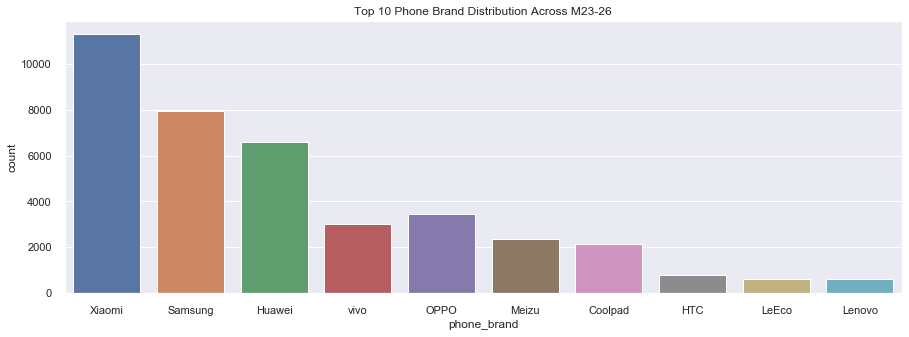

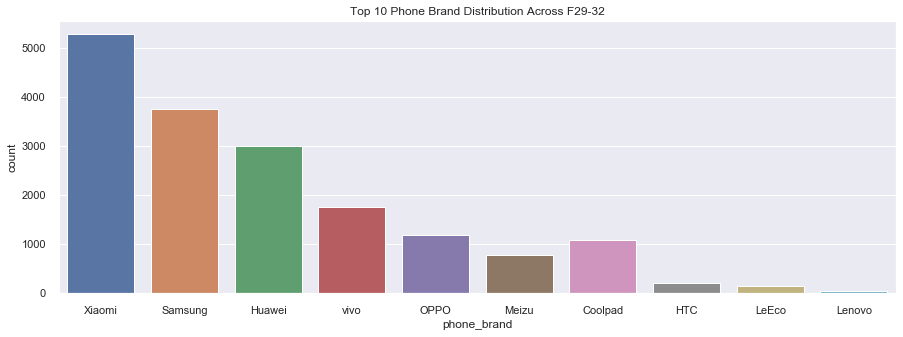

...

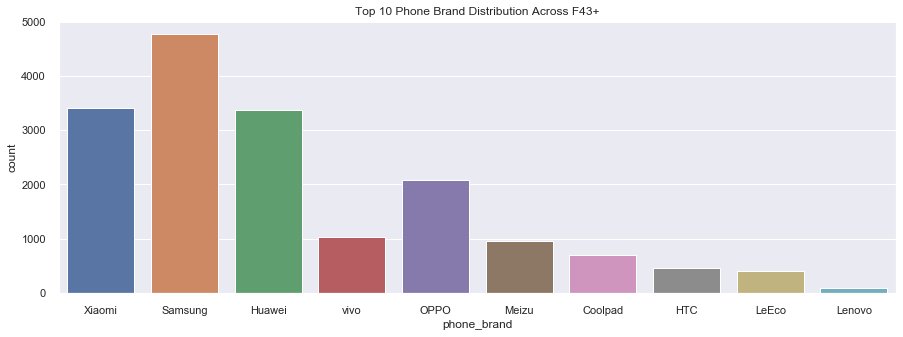

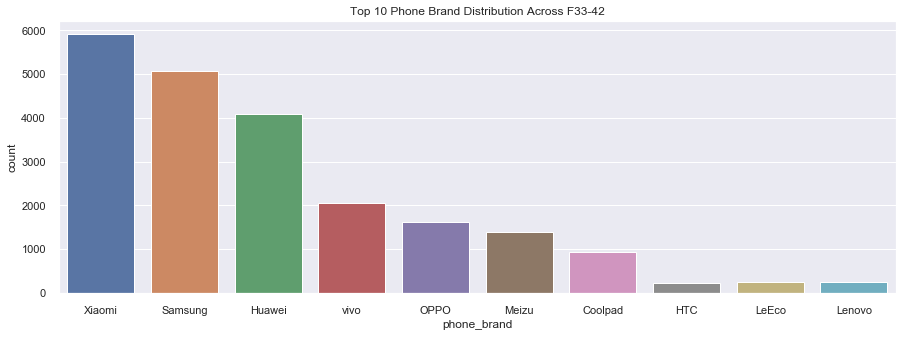

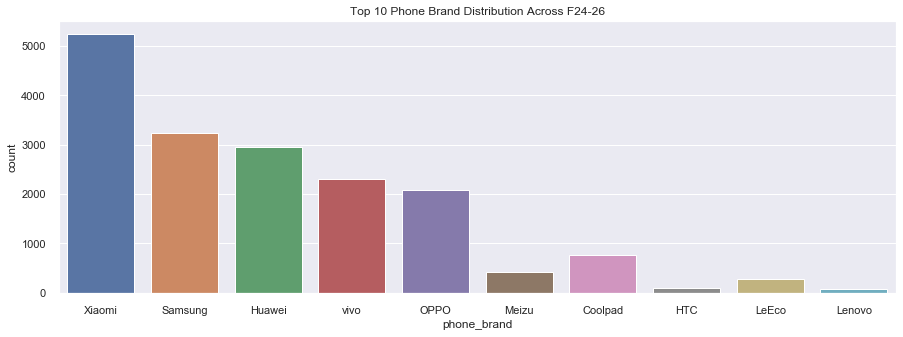

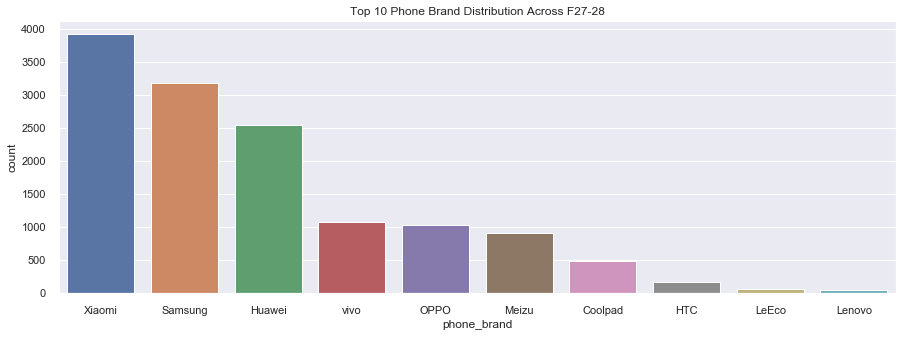

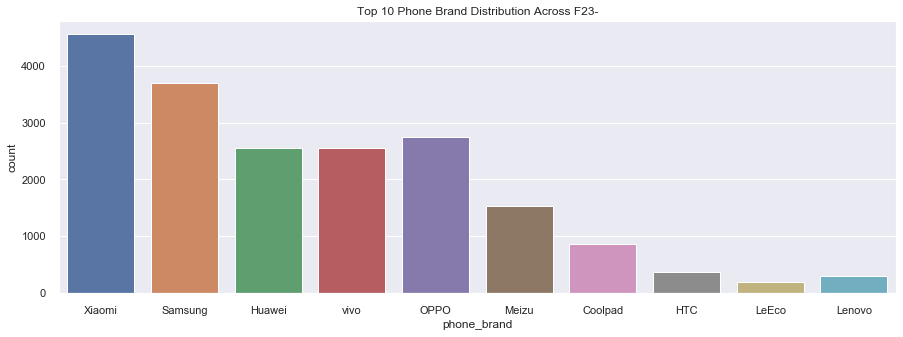

In [214]:
for i in df_final['group'].unique():
    #print ('-----------',i,'-----------')
    #print (df_final[df_final['group']==i]['phone_brand'].value_counts().head(10))
    fig, axis1 = plt.subplots(1,1,figsize=(15,5))
    sns.countplot(x='phone_brand' ,order=df_final.phone_brand.value_counts().iloc[:10].index, data=df_final[df_final['group']==i], ax=axis1)
    plt.title("Top 10 Phone Brand Distribution Across " + i)

### Popular device among all age group

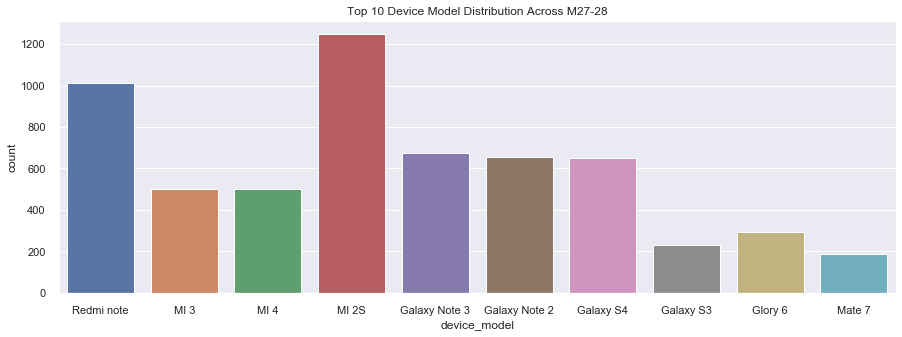

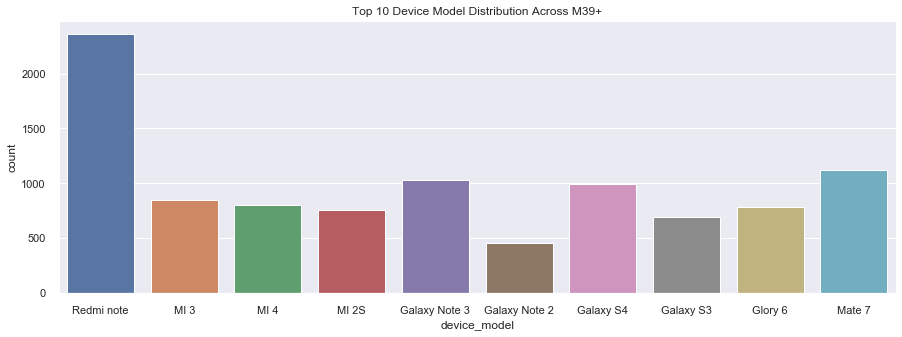

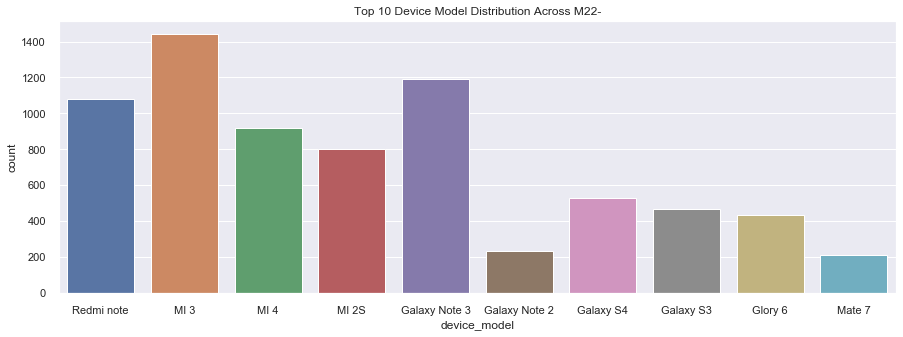

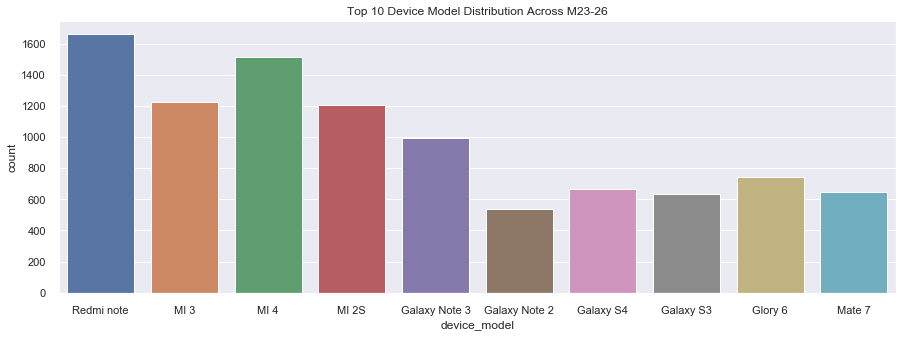

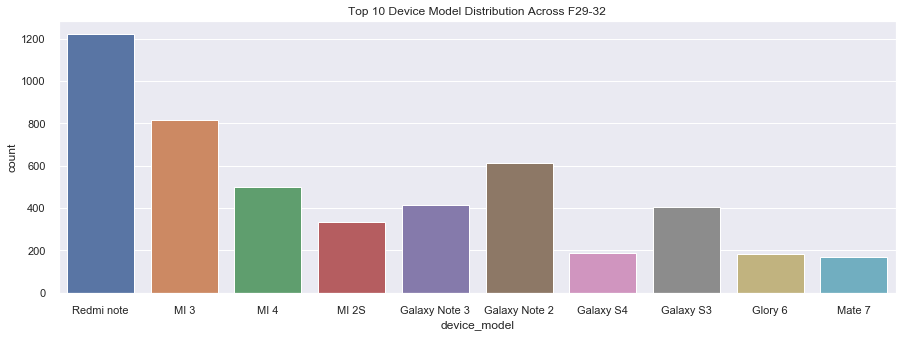

...

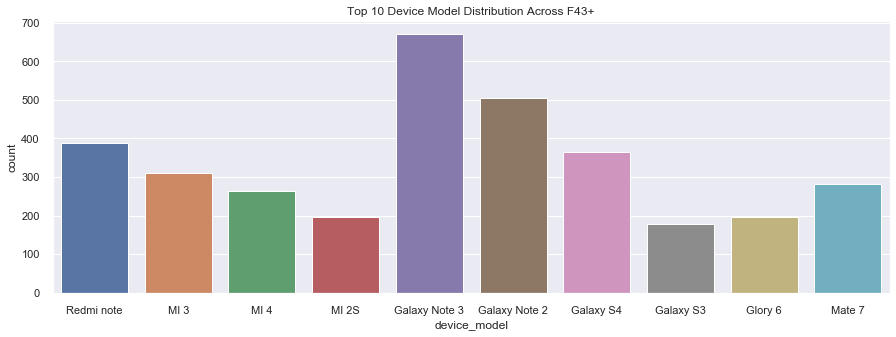

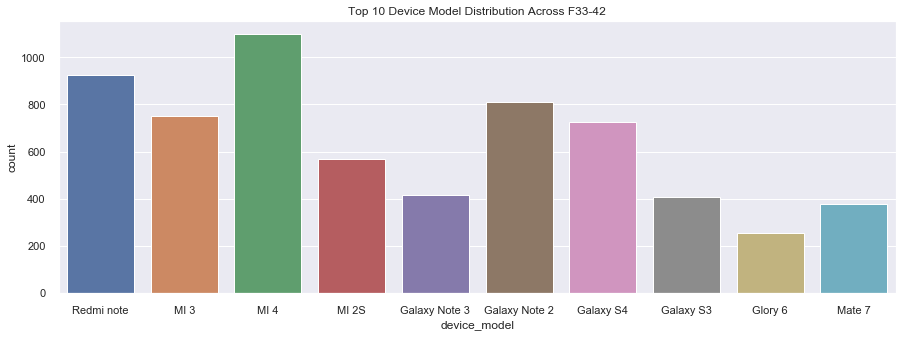

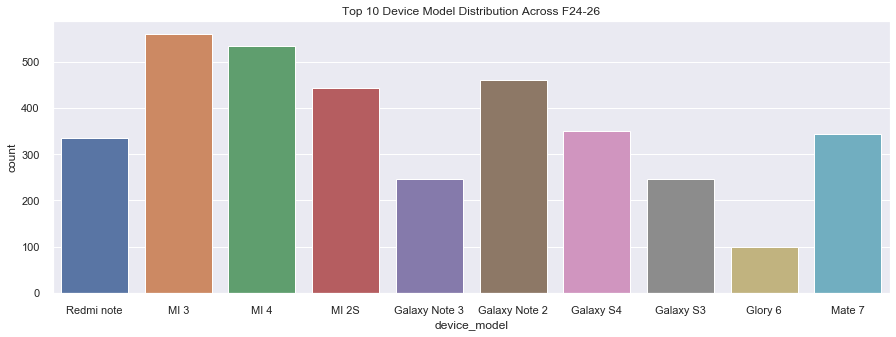

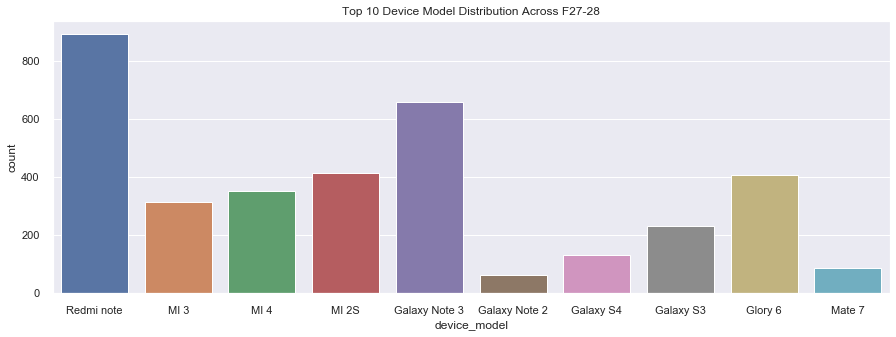

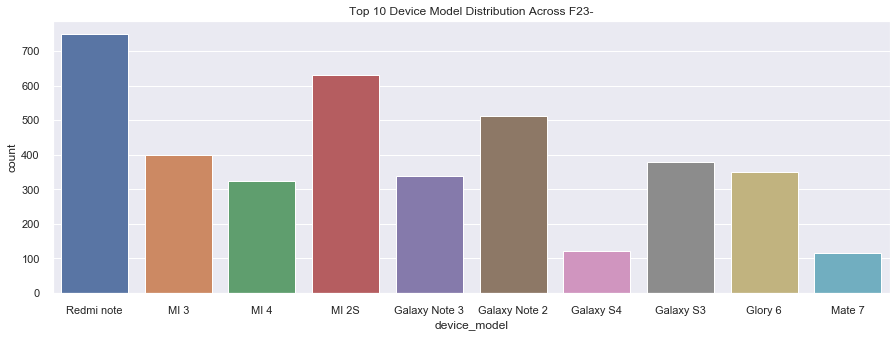

In [215]:
for i in df_final['group'].unique():
    #print ('-----------',i,'-----------')
    #print (df_final[df_final['group']==i]['device_model'].value_counts().head(10))
    fig, axis1 = plt.subplots(1,1,figsize=(15,5))
    sns.countplot(x='device_model' ,order=df_final.device_model.value_counts().iloc[:10].index, data=df_final[df_final['group']==i], ax=axis1)
    plt.title("Top 10 Device Model Distribution Across " + i)
    

In [216]:
states_list = df_events_data['city'].groupby(df_events_data['state']).count()
states_list

state
Bihar          35472
Gujarat        42881
Karnataka      99072
Kerala         23148
Punjab         26195
WestBengal    196203
Name: city, dtype: int64

In [217]:
pd.crosstab(df_events_data['city'],df_events_data['state'],margins=True).sort_values('All',ascending=False)

state,Bihar,Gujarat,Karnataka,Kerala,Punjab,WestBengal,All
city,,,,,,,
All,35472,42881,99072,23148,26195,196203,422971
Calcutta,0,0,0,0,0,122381,122381
Bangalore,0,0,49939,0,0,0,49939
Arambagh,0,0,0,0,0,1929,1929
Channapatna,0,0,1815,0,0,0,1815
Ponnani,0,0,0,1665,0,0,1665
Surat,0,1631,0,0,0,0,1631
Bagaha,1595,0,0,0,0,0,1595
Dinapur,1581,0,0,0,0,0,1581


In [218]:
pd.crosstab(df_events_data['city'],df_events_data['state'][df_events_data['state'] == 'Karnataka'],margins=True)\
.sort_values('All',ascending=False).head(10)

state,Karnataka,All
city,,
All,99072,99072
Bangalore,49939,49939
Channapatna,1815,1815
Ramanagaram,1318,1318
Chitradurga,1308,1308
Tumkur,1244,1244
Karwar,1198,1198
Bijapur,1164,1164
Challakere,1104,1104


In [219]:
pd.crosstab(df_events_data['city'],df_events_data['state'][df_events_data['state'] == 'WestBengal'],margins=True)\
.sort_values('All',ascending=False).head(10)

state,WestBengal,All
city,,
All,196203,196203
Calcutta,122381,122381
Arambagh,1929,1929
Gangarampur,1366,1366
IngrajBazar,1352,1352
Krishnanagar,1344,1344
Panihati,1341,1341
RampurHat,1328,1328
Naihati,1267,1267


In [220]:
pd.crosstab(df_events_data['city'],df_events_data['state'][df_events_data['state'] == 'Gujarat'],margins=True)\
.sort_values('All',ascending=False).head(10)

state,Gujarat,All
city,,
All,42881,42881
Surat,1631,1631
Jetpur,1479,1479
Bardoli,1475,1475
Unjha,1221,1221
Veraval,1193,1193
Dhoraji,1145,1145
Ahmadabad,1131,1131
Disa,1047,1047


In [221]:
pd.crosstab(df_events_data['city'],df_events_data['state'][df_events_data['state'] == 'Bihar'],margins=True)\
.sort_values('All',ascending=False).head(10)

state,Bihar,All
city,,
All,35472,35472
Bagaha,1595,1595
Dinapur,1581,1581
Purnia,1330,1330
Phulwari,1265,1265
Kishanganj,1191,1191
Masaurhi,1180,1180
Madhipura,1129,1129
Bhabua,1108,1108


In [222]:
pd.crosstab(df_events_data['city'],df_events_data['state'][df_events_data['state'] == 'Punjab'],margins=True)\
.sort_values('All',ascending=False).head(10)

state,Punjab,All
city,,
All,26195,26195
Batala,1219,1219
Sunam,1117,1117
Moga,1085,1085
Bathinda,1077,1077
Firozpur,1052,1052
Patiala,1042,1042
Gobindgarh,1037,1037
Gurdaspur,968,968


In [223]:
pd.crosstab(df_events_data['city'],df_events_data['state'][df_events_data['state'] == 'Kerala'],margins=True)\
.sort_values('All',ascending=False).head(10)

state,Kerala,All
city,,
All,23148,23148
Ponnani,1665,1665
Thiruvananthapuram,1384,1384
Talipparamba,1290,1290
Kottayam,1138,1138
Malappuram,1135,1135
Alappuzha,971,971
Koyilandi,938,938
Kollam,934,934


In [224]:
pd.crosstab(df_gender_age_train['gender'],df_gender_age_train['group'])

group,F23-,F24-26,F27-28,F29-32,F33-42,F43+,M22-,M23-26,M27-28,M29-31,M32-38,M39+
gender,,,,,,,,,,,,
F,5050,4190,3118,4628,5561,4194,0,0,0,0,0,0
M,0,0,0,0,0,0,7488,9605,5445,7309,9476,8581


In [225]:
pd.crosstab(df_gender_age_train['age'],df_gender_age_train['gender'],margins=True).sort_values('All',ascending=False).head(10)

gender,F,M,All
age,,,
All,26741,47904,74645
26,1620,2920,4540
27,1623,2853,4476
29,1555,2788,4343
28,1495,2592,4087
25,1350,2390,3740
30,1223,2507,3730
24,1220,2281,3501
23,1101,2014,3115


In [226]:
pd.crosstab(df_phone_brand_device_model['device_model'],df_phone_brand_device_model['phone_brand'],margins=True).sort_values('All',ascending=False).head(10)

phone_brand,Aiyouni,Candied,Coolby,Feixun,Focus,ASUS,Aipair,Amagatarai,Amoi,Bai Li Feng,...,瑞米,瑞高,百加,米奇,西门子,赛博宇华,金星数码,飞秒,首云,All
device_model,,,,,,,,,,,,,,,,,,,,,
All,48,4,76,9,50,67,46,161,21,26,...,1,1,12,8,1,1,4,2,2,87726
Redmi note,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,3500
MI 3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,2739
MI 2S,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,2547
Galaxy Note 3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,2378
MI 4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,2256
Galaxy S4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1910
Galaxy Note 2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1877
Glory 6,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1471


In [227]:
df_phone_brand_device_model['device_model'].groupby(df_phone_brand_device_model['phone_brand']).count().sort_values(ascending=False).head(10)

phone_brand
Xiaomi     21645
Samsung    19211
Huawei     15181
vivo        7596
OPPO        6717
Meizu       5531
Coolpad     3979
HTC         1272
Lenovo       982
LeEco        841
Name: device_model, dtype: int64

In [228]:
df_phone_brand_device_model['phone_brand'].groupby(df_phone_brand_device_model['device_model']).count().sort_values(ascending=False).head(10)

device_model
Redmi note       3500
MI 3             2739
MI 2S            2547
Galaxy Note 3    2378
MI 4             2256
Galaxy S4        1910
Galaxy Note 2    1877
Glory 6          1471
Honor Play 4X    1279
Glory 3C         1206
Name: phone_brand, dtype: int64

<a id=section5></a>
## 5. Conclusion

**Brief summary of we discovered based on results**

- Insaid Telecom needs to perform few promotional activities for being strong competitor in the market:
        - Special Plan for different age band
        - Special Plan along with tie-up with top running Mobile Brand in the specific market
        - Re-visit their existing plan for Tier-1 city and rest small city
        
- Insaid Telecom has strong market place with 50 millions active devices on daily basis. Insaid telecom has High potential to engage more customers by giving promotions.

<a id=section6></a>
## 6. Core Team

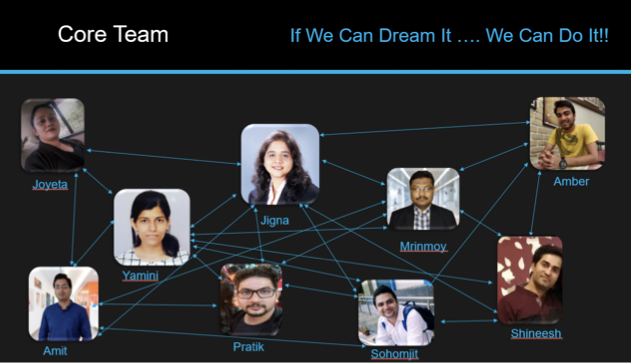

| Name | Email |
| --- | --- |
| Amit | amit.kr.dhanuka@gmail.com |
| Amber | amberjain.iet@gmail.com |
| Jigna | jignazt@yahoo.com |
| Joyeta | joyeta.instru@gmail.com |
| Mrinmoy | mrinmoydey.dey@gmail.com |
| Pratik | pratikbarjatya@gmail.com |
| Shineesh | Shineesh@gmail.com |
| Sohomjit | sunny.sohomjit13@gmail.com |
| Yamini | yaminijoshi1989@gmail.com |


## THANK YOU !